# Capstone Project 2: Analisis Popularitas Listing Airbnb di Bangkok

# Latar Belakang & Problem Statement

## Latar Belakang
Airbnb di Bangkok memiliki lebih dari 14.000 listing aktif, dengan rata-rata pendapatan tahunan sekitar $7.443 dan tingkat okupansi sekitar 44%. Meskipun ada variasi dalam kinerja listing, beberapa faktor utama seperti harga, jenis kamar, lokasi, dan ulasan berperan penting dalam menentukan popularitas dan potensi pendapatan. Namun, banyak listing yang tidak optimal dalam menarik tamu, terutama yang jarang memperbarui informasi dan mendapatkan ulasan.

**Sumber:** [Airroi](https://www.airroi.com/report/world/thailand/bangkok/bangkok)

## Problem Statement
Tujuan dari analisis ini adalah untuk mengidentifikasi faktor-faktor yang mempengaruhi performa listing Airbnb di Bangkok, baik dalam hal popularitas maupun potensi pendapatan. Faktor-faktor ini akan dieksplorasi berdasarkan data yang tersedia, termasuk jenis kamar, harga, lokasi, serta ulasan tamu. Dengan pemahaman yang lebih baik mengenai faktor-faktor ini, Airbnb dapat memberikan rekomendasi yang lebih tepat kepada host untuk mengoptimalkan listing mereka.

Analisis ini bertujuan untuk menggali lebih dalam faktor-faktor yang memengaruhi performa listing dan memberikan rekomendasi untuk mengoptimalkan potensi pendapatan dan okupansi. Langkah pertama yang akan dilakukan adalah data cleaning dan feature engineering untuk memastikan kualitas data yang digunakan, serta menyiapkan fitur tambahan yang dapat memperkaya analisis.

# Data Preparation 
Data cleaning dan feature engineering adalah tahap pertama yang sangat penting. Data yang digunakan akan dievaluasi untuk memastikan kualitasnya, dengan memeriksa adanya nilai yang hilang, duplikasi, atau data yang tidak konsisten. Selain itu, fitur baru yang dapat memperkaya analisis juga akan dikembangkan untuk memberikan wawasan lebih dalam terhadap faktor-faktor yang mempengaruhi performa listing.

## Import Library
Pada tahap ini, kita akan mengimpor library yang diperlukan untuk analisis data dan visualisasi. Beberapa library yang akan digunakan di antaranya:

In [1]:
# Import library yang akan digunakan
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import requests
import folium

import warnings
warnings.filterwarnings('ignore')

| Library             | Kegunaan                                                                                                                                                 |
| ------------------- | -------------------------------------------------------------------------------------------------------------------------------------------------------- |
| `pandas`            | Digunakan untuk manipulasi data, seperti pembersihan, transformasi, dan analisis data tabular.                                                           |
| `numpy`             | Digunakan untuk operasi numerik, terutama untuk menghitung statistik dan manipulasi array/matriks.                                                       |
| `matplotlib.pyplot` | Digunakan untuk visualisasi data, terutama grafik dasar seperti histogram, boxplot, dll.                                                                 |
| `seaborn`           | Digunakan untuk visualisasi data tingkat lanjut dengan desain yang lebih menarik dan informatif (misalnya, heatmap untuk missing values, pairplot, dll). |
| `scipy.stats`       | Digunakan untuk analisis statistik, seperti uji normalitas, uji hipotesis, dan uji outlier.                                                              |
| `requests`          | Digunakan untuk permintaan HTTP, berguna jika Anda mengunduh data dari API atau sumber eksternal.                                                        |
| `folium`            | Digunakan untuk visualisasi peta interaktif, berguna jika data melibatkan koordinat geografis (latitude/longitude).                                      |
| `warnings`            | Mengatur agar Python mengabaikan semua peringatan (warnings) yang muncul selama eksekusi kode.                                      |

## Load Dataset
Langkah pertama dalam analisis ini adalah memuat dataset yang akan digunakan. 
Impor data dilakukan dari dua sumber: 
- Dataset utama dalam format CSV yang berisi informasi mengenai listing Airbnb di Bangkok.
- Data GeoJSON yang menggambarkan distrik-distrik di Bangkok yang akan digunakan untuk visualisasi geografis.

In [2]:
# Load clean dataset Airbnb Listings Bangkok
url = 'https://raw.githubusercontent.com/Quinntes/airbnb_listings_bangkok/refs/heads/main/Airbnb%20Listings%20Bangkok.csv'
df_raw = pd.read_csv(url)

In [3]:
# Load file GeoJSON
url = 'https://raw.githubusercontent.com/Quinntes/airbnb_listings_bangkok/main/bangkok-districts.geojson'

# Mengunduh file GeoJSON menggunakan requests
response = requests.get(url)
geojson_data = response.json()  # Mengambil data GeoJSON

In [4]:
# Memeriksa beberapa informasi tentang data GeoJSON untuk memastikan struktur data yang benar
# Cek key yang ada di dalam 'properties' dari setiap fitur GeoJSON untuk memastikan lokasi nama distrik.
for feature in geojson_data['features'][:1]:  # Menampilkan 5 fitur pertama
    print(feature['properties'].keys())  # Menampilkan key yang ada pada properties setiap fitur
    print(feature['properties'])  # Menampilkan seluruh data dalam properties untuk melihat atribut yang tersedia

# Dari hasil pemeriksaan, dikeathui bahwa nama distrik terdapat pada key 'dname' (bahasa Thai)
# dan 'dname_e' (bahasa Inggris), sehingga bisa digunakan salah satu dari key tersebut untuk menampilkan nama distrik di peta.

dict_keys(['OBJECTID', 'water', 'AREA', 'dcode', 'dname', 'dname_e', 'pcode', 'no_female', 'pname', 'no_male', 'no_health', 'no_temple', 'no_commu', 'no_hos', 'no_sch'])
{'OBJECTID': 29, 'water': 918, 'AREA': 11804564.0, 'dcode': '1025', 'dname': 'เขตบางพลัด', 'dname_e': 'Bang Phlat', 'pcode': '10', 'no_female': 53750, 'pname': 'กรุงเทพมหานคร', 'no_male': 46569, 'no_health': 1, 'no_temple': 23, 'no_commu': 46, 'no_hos': 0, 'no_sch': 11}


## Warna

In [5]:
# Set the color palette for your plot using Rausch colors
rausch = ['#FFF9FB', '#FFF4F7', '#FFE5E8', '#FFD3D6', '#FFBBBF', '#FF9A9F', '#FF7A7E', '#FF5A5F']

## Backup Raw Dataset
Sebelum melakukan proses **data cleaning**, sangat penting untuk membuat salinan (backup) dari dataset asli. Hal ini akan memastikan bahwa data original tetap aman dan dapat dibandingkan dengan data yang sudah dibersihkan. Backup juga memberikan fleksibilitas jika kita ingin **rollback** ke data awal tanpa perlu me-load ulang file CSV yang besar.

Langkah ini hanya membuat duplikat DataFrame di memori Python, sehingga perubahan pada **`df_copy`** tidak akan mempengaruhi dataset asli **`df_raw`**.

**Tujuan Backup:**
1. Mencegah kehilangan data asli jika terjadi kesalahan selama proses cleaning.
2. Memungkinkan perbandingan antara dataset yang telah dibersihkan dengan dataset asli.
3. Memberikan fleksibilitas untuk rollback ke dataset awal tanpa perlu me-load ulang file.

In [6]:
# Backup Raw Dataset
df_copy = df_raw.copy()

## Data Overview
Sebelum masuk ke analisis, penting memastikan data dalam kondisi bersih dan siap pakai. Proses ini meliputi melihat bentuk data, pengecekan missing values, duplikasi, koreksi tipe data, dan membangun fitur tambahan agar informasi yang tersembunyi bisa ditarik keluar (feature engineering).

In [7]:
# Cek dimensi data
print(f"Jumlah baris: {df_copy.shape[0]}, Jumlah kolom: {df_copy.shape[1]}")

# Menampilkan informasi dataset
df_copy.info()  # Memeriksa tipe data dan jumlah entri dalam dataset

Jumlah baris: 15854, Jumlah kolom: 17
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15854 entries, 0 to 15853
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Unnamed: 0                      15854 non-null  int64  
 1   id                              15854 non-null  int64  
 2   name                            15846 non-null  object 
 3   host_id                         15854 non-null  int64  
 4   host_name                       15853 non-null  object 
 5   neighbourhood                   15854 non-null  object 
 6   latitude                        15854 non-null  float64
 7   longitude                       15854 non-null  float64
 8   room_type                       15854 non-null  object 
 9   price                           15854 non-null  int64  
 10  minimum_nights                  15854 non-null  int64  
 11  number_of_reviews               15854 non-null  int64  

### Keterangan Kolom Dataset
| Nama Kolom                         | Deskripsi                                                                 |
|------------------------------------|---------------------------------------------------------------------------|
| Unnamed: 0                         | Index otomatis dari file CSV (bisa diabaikan/dihapus).                    |
| id                                 | ID unik untuk setiap listing.                                             |
| name                               | Nama listing Airbnb.                                                      |
| host_id                            | ID unik pemilik (host).                                                   |
| host_name                          | Nama pemilik listing.                                                     |
| neighbourhood                      | Lokasi/area geografis listing.                                            |
| latitude                           | Koordinat latitude listing.                                               |
| longitude                          | Koordinat longitude listing.                                              |
| room_type                          | Jenis ruang (Entire home/apt, Private room, Shared room, Hotel).          |
| price                              | Harga per malam.                                                          |
| minimum_nights                     | Jumlah malam minimum untuk menginap.                                       |
| number_of_reviews                  | Total jumlah ulasan yang dimiliki listing.                                |
| last_review                        | Tanggal ulasan terakhir.                                                  |
| reviews_per_month                  | Rata-rata ulasan per bulan.                                               |
| calculated_host_listings_count     | Jumlah listing yang dimiliki host di area tersebut.                       |
| availability_365                   | Jumlah hari listing tersedia dalam setahun (maks 365).                    |
| number_of_reviews_ltm              | Jumlah ulasan dalam 12 bulan terakhir.

In [8]:
# Menampilkan beberapa baris pertama dari dataset untuk memahami struktur data
df_copy.head()

# Statistik deskriptif tipe data objek
df_copy.describe(include='object')

,name,host_name,neighbourhood,room_type,last_review
count,15846,15853,15854,15854,10064
unique,14794,5312,50,4,1669
top,New! La Chada Night Market studio 2PPL near MRT,Curry,Vadhana,Entire home/apt,2022-12-11
freq,45,228,2153,8912,189


In [9]:
# Cek jenis ruangan dan jumlahnya
df_copy['room_type'].value_counts()

room_type
Entire home/apt    8912
Private room       5770
Hotel room          649
Shared room         523
Name: count, dtype: int64

In [10]:
# Cek nama neighbourhood dan jumlahnya
df_copy['neighbourhood'].value_counts().head(10)

neighbourhood
Vadhana         2153
Khlong Toei     2097
Huai Khwang     1125
Ratchathewi     1114
Bang Rak         827
Sathon           809
Phra Nakhon      619
Phra Khanong     558
Chatu Chak       548
Bang Na          458
Name: count, dtype: int64

### Checklist Decision Data Overview

In [11]:
# Drop kolom Unnamed
df_copy.drop(columns=['Unnamed: 0'], inplace=True)

#### Drop Kolom `Unnamed: 0`
Kolom ini merupakan index otomatis dari file CSV saat proses export, sehingga tidak memiliki nilai informasi yang relevan dengan analisis bisnis. Maka dari itu, kolom ini dihapus untuk menjaga kebersihan dataset.

## Missing Values Check
Cek kolom mana yang memiliki missing values.

In [12]:
# Jumlah missing values per kolom
df_copy.isnull().sum()

id                                   0
name                                 8
host_id                              0
host_name                            1
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5790
reviews_per_month                 5790
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
dtype: int64

In [13]:
# Persentase missing values per kolom
(df_copy.isnull().sum() / df_copy.shape[0]) * 100

id                                 0.000000
name                               0.050460
host_id                            0.000000
host_name                          0.006308
neighbourhood                      0.000000
latitude                           0.000000
longitude                          0.000000
room_type                          0.000000
price                              0.000000
minimum_nights                     0.000000
number_of_reviews                  0.000000
last_review                       36.520752
reviews_per_month                 36.520752
calculated_host_listings_count     0.000000
availability_365                   0.000000
number_of_reviews_ltm              0.000000
dtype: float64

### Checklist Decision Missing Values
#### Handling Missing Values: `name` & `host_name`

In [14]:
df_copy['name'].fillna('No Name', inplace=True)

In [15]:
df_copy['host_name'].fillna('Unknown', inplace=True)

- Kolom `name` dan `host_name` memiliki missing values masing-masing sebesar 0.05% dan 0.006% dari total data.
- Kolom ini **tidak digunakan dalam analisis numerik atau segmentasi**, karena:
  - `name`: Hanya sebagai label deskriptif listing.
  - `host_name`: Tidak relevan karena menganalisis host berdasarkan **jumlah listing yang dimiliki (host_type)**, bukan nama perorangan.
- Namun, untuk menjaga konsistensi data (terutama saat menampilkan dataframe di visualisasi), missing values ini diisi dengan placeholder:
  - `name` → 'No Name'
  - `host_name` → 'Unknown'
- Hal ini mencegah visualisasi atau eksplorasi data terganggu oleh nilai NaN yang sebenarnya **tidak mempengaruhi insight bisnis yang ingin disampaikan kepada investor**.

#### Handling Missing Values: `last_review` & `reviews_per_month`

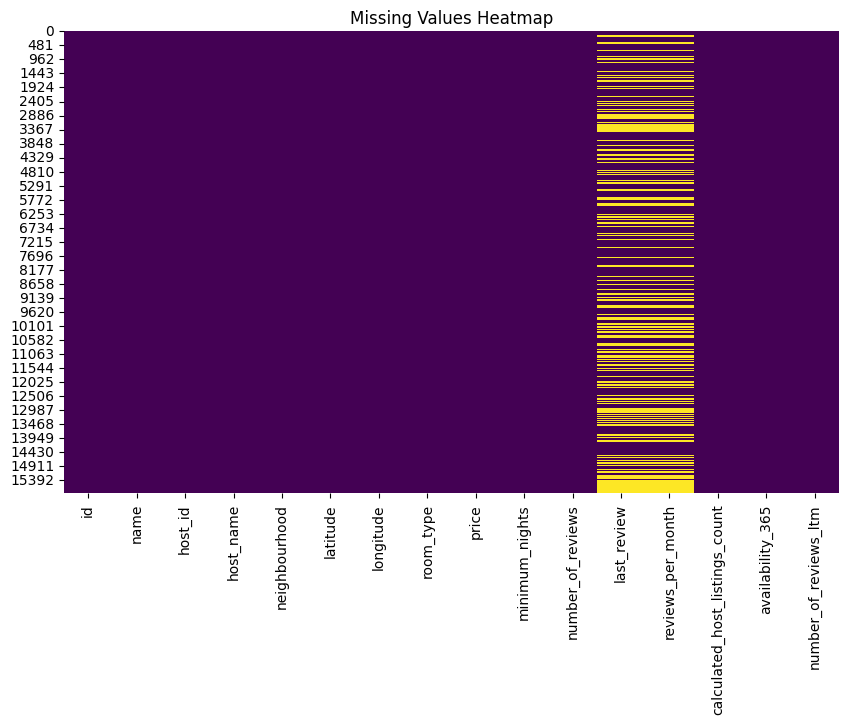

In [16]:
# Visualisasi missing values
plt.figure(figsize=(10, 6))
sns.heatmap(df_copy.isnull(), cbar=False, cmap='viridis')
plt.title('Missing Values Heatmap')
plt.show()

In [17]:
# Mengecek apakah baris yang memiliki NaN di 'last_review' juga memiliki NaN di 'reviews_per_month'
missing_relationship = df_copy[['last_review', 'reviews_per_month']][df_copy['last_review'].isna() & df_copy['reviews_per_month'].isna()]

# Mereset indeks
missing_relationship_reset = missing_relationship.reset_index(drop=True)

# Menampilkan jumlah baris yang memiliki NaN di kedua kolom
print(f"Jumlah baris dengan NaN di kedua kolom: {missing_relationship_reset.shape[0]}")

# Menampilkan beberapa data yang memiliki NaN di kedua kolom
print(missing_relationship_reset.head(20))

Jumlah baris dengan NaN di kedua kolom: 5790
   last_review  reviews_per_month
0          NaN                NaN
1          NaN                NaN
2          NaN                NaN
3          NaN                NaN
4          NaN                NaN
5          NaN                NaN
6          NaN                NaN
7          NaN                NaN
8          NaN                NaN
9          NaN                NaN
10         NaN                NaN
11         NaN                NaN
12         NaN                NaN
13         NaN                NaN
14         NaN                NaN
15         NaN                NaN
16         NaN                NaN
17         NaN                NaN
18         NaN                NaN
19         NaN                NaN


Jika tidak ada ulasan terbaru (`last_review` kosong), maka `reviews_per_month` otomatis juga kosong, yang mengindikasikan bahwa baris-baris ini mungkin adalah listing yang tidak memiliki ulasan sama sekali. Oleh karena itu, untuk menangani missing values pada kedua kolom ini, langkah yang akan diambil adalah sebagai berikut:
- Membuat fitur baru `has_review` yang bernilai 1 jika `last_review` ada, dan 0 jika `last_review` kosong. Fitur ini akan memberikan gambaran yang jelas mengenai apakah listing memiliki ulasan atau tidak.
- Imputasi nilai `reviews_per_month` dengan 0, karena jika tidak ada ulasan yang diberikan, maka tidak ada ulasan per bulan yang tercatat. Imputasi ini akan memastikan bahwa data tetap konsisten dan dapat digunakan dalam analisis lebih lanjut, tanpa kehilangan informasi terkait performa ulasan.

Dengan langkah ini, maka dapat memastikan bahwa kedua kolom tersebut ditangani dengan cara yang logis dan menjaga kualitas dataset tanpa mengorbankan data penting yang tersedia.

In [18]:
# Mengisi missing values di 'reviews_per_month' dengan 0
df_copy['reviews_per_month'].fillna(0, inplace=True)

## Duplicate Check
Penting untuk memeriksa apakah ada **baris duplikat** dalam dataset sebelum melanjutkan ke proses analisis. Meskipun ID listing sudah tampaknya unik, proses pengecekan duplikat tetap perlu dilakukan untuk memastikan bahwa tidak ada data error yang bisa mempengaruhi kualitas dan akurasi analisis.

### Checklist Decision Duplicate
#### Duplicate Row Check

In [19]:
# Cek duplicate rows
df_copy.duplicated().sum()

np.int64(0)

In [20]:
# Cek duplikasi berdasarkan kombinasi kolom tertentu
duplicate_check = df_copy[['id', 'host_id']].duplicated().sum()
duplicate_check

np.int64(0)

- Hasil pemeriksaan menunjukkan **tidak ada baris duplikat identik** di dataset.
- Ini menunjukkan bahwa data sudah unik secara listing ID.
- Namun, pengecekan duplikat tetap wajib dilakukan sebagai langkah validasi awal untuk memastikan **tidak ada data error yang akan memengaruhi akurasi analisis dan rekomendasi kepada investor.**

## Data Type Correction
Sebelum melanjutkan analisis, penting untuk memastikan bahwa kolom numerik dan tanggal memiliki **tipe data yang benar**. Koreksi tipe data ini akan memastikan bahwa proses perhitungan dan analisis dapat dilakukan dengan akurat dan efisien.

### Checklist Decision Data Type
#### Data Type Correction: Kolom `price`& `last_review`

In [21]:
# Konversi kolom price ke float
df_copy['price'] = df_copy['price'].astype(float)

# Konversi kolom tanggal
df_copy['last_review'] = pd.to_datetime(df_copy['last_review'], errors='coerce')

# Mengubah kolom room_type dan neighbourhood menjadi category
df_copy['room_type'] = df_copy['room_type'].astype('category')
df_copy['neighbourhood'] = df_copy['neighbourhood'].astype('category')

- Kolom `price` sudah bertipe numerik (int64) dari awal.
- Untuk menjaga konsistensi precision saat perhitungan estimasi revenue (yang mungkin melibatkan pembagian), kolom ini diubah menjadi tipe data float.
- Hal ini memastikan seluruh perhitungan harga (mean, median, korelasi) dapat diproses secara akurat tanpa error parsing di tahap analisis selanjutnya.
- Kolom `last_review` diubah dari object ke datetime agar bisa digunakan dalam perhitungan durasi dan analisis tren waktu.
- `room_type` berisi nilai yang terbatas ("Entire home/apt", "Private room", "Hotel room", "Shared room"), sehingga sangat cocok untuk menggunakan tipe category dan mengubahnya akan memberikan efisiensi memori.
- `neighbourhood` berisi berbagai nama lokasi atau area, yang jumlahnya terbatas, sehingga juga lebih efisien jika diubah menjadi category.

#### Whitespace Trimming

In [22]:
# Menghilangkan whitespace ekstra
df_copy['room_type'] = df_copy['room_type'].str.strip()
df_copy['neighbourhood'] = df_copy['neighbourhood'].str.strip()
df_copy['host_name'] = df_copy['host_name'].str.strip()

Trim whitespace pada kolom kategorikal agar tidak terjadi error grouping saat aggregasi atau visualisasi.
Meski data terlihat bersih, langkah ini tetap dijalankan sebagai langkah pencegahan.

## Outlier Detection

<Figure size 1500x800 with 0 Axes>

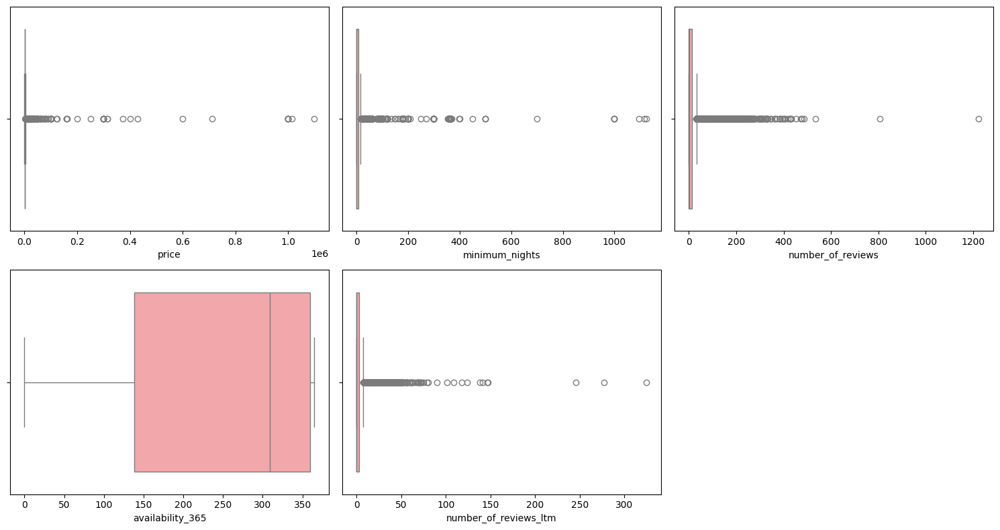

In [23]:
# Visualisasi Outlier dengan Boxplot
plt.figure(figsize=(15, 8))

# Boxplot untuk 'price'
plt.figure(figsize=(15, 8))
plt.subplot(2, 3, 1)
sns.boxplot(x=df_copy['price'], color='#FF9A9F')

# Boxplot untuk 'minimum_nights'
plt.subplot(2, 3, 2)
sns.boxplot(x=df_copy['minimum_nights'], color='#FF9A9F')

# Boxplot untuk 'number_of_reviews'
plt.subplot(2, 3, 3)
sns.boxplot(x=df_copy['number_of_reviews'], color='#FF9A9F')

# Boxplot untuk 'availability_365'
plt.subplot(2, 3, 4)
sns.boxplot(x=df_copy['availability_365'], color='#FF9A9F')

# Boxplot untuk 'number_of_reviews_ltm'
plt.subplot(2, 3, 5)
sns.boxplot(x=df_copy['number_of_reviews_ltm'], color='#FF9A9F')

plt.tight_layout()
plt.show()

**Insight Result :**

`price`:
- Data right skewed
- Mayoritas listing terkonsentrasi di rentang harga yang sangat rendah, terlihat dari boxplot yang padat di sisi kiri grafik
- Terdapat listing dengan harga yang jauh lebih tinggi daripada kebanyakan listing lain, membentuk outlier yang terletak jauh di sisi kanan grafik
 - Variasi harga yang luas ini mengindikasikan adanya segmentasi pasar
 - Perlu menangani outlier untuk melihat apakah ada listing dengan harga 0

`minimum_nights`:
- Data right skewed
- Terlihat ada banyak outlier pada sisi kiri, yang menunjukkan listing dengan durasi menginap yang sangat singkat
- Ada juga listing dengan durasi menginap yang lebih panjang yang bisa menunjukkan kebijakan tertentu dari host
- Perlu menangani outlier untuk melihat apakah ada listing dengan `minimum_nights` lebih dari satu tahun karena tidak sesuai dengan model bisnis Airbnb yang lebih fokus pada sewa jangka pendek

`number_of_reviews`:
- Data right skewed
- Ada beberapa outlier di sisi kanan yang menunjukkan listing dengan jumlah ulasan yang sangat tinggi (lebih dari 200)
- Sebagian besar listing memiliki jumlah ulasan yang lebih rendah
- Tidak perlu menangani outlier pada kolom `number_of_reviews` karena distribusi data yang right skewed sudah sesuai dengan pola umum di Airbnb

`availability_365`:
- Terlihat lebih simetris
- Sebagian besar listing tersedia selama 250 hingga 365 hari dalam setahun
- Tidak menunjukkan adanya outlier

`number_of_reviews_ltm`:
- Data right skewed
- Beberapa listing memiliki jumlah ulasan yang sangat tinggi dalam 12 bulan terakhir (lebih dari 100 hingga 200 ulasan)
- Sebagian besar listing memiliki sedikit ulasan dalam 12 bulan terakhir
- Tidak perlu menangani outlier karena bisa memberikan wawasan yang berharga tentang listing premium atau high-demand yang sangat populer di pasar Airbnb

In [24]:
# Cek sebaran price
print(f"Jumlah listing dengan harga 0: {df_copy[df_copy['price'] == 0].shape[0]}")
print(f"Jumlah listing dengan harga < 500: {df_copy[df_copy['price'] < 500].shape[0]}")

Jumlah listing dengan harga 0: 1
Jumlah listing dengan harga < 500: 753


#### Outlier Handling: `price` = 0 & Luxury Listings

In [25]:
df_copy = df_copy[df_copy['price'] > 0]

- Listing dengan `price = 0` dihapus dari dataset karena:
  - Biasanya merupakan kesalahan input data (tidak relevan untuk analisis performa listing).
  - Tidak masuk akal dari sisi bisnis platform Airbnb karena listing gratis tidak dapat dimonetisasi.
  - Mengganggu perhitungan estimasi revenue & analisis segmentasi harga.
- Luxury Listings (dengan price sangat tinggi) **tidak dihapus** karena:
  - Listing dengan harga premium adalah segmen pasar yang sah (luxury travel market).
  - Membantu host memahami diferensiasi performa di segmen high-end market.
  - Akan dianalisis secara khusus dalam segmentasi granular (price_category).

#### Outlier Handling: `minimum_nights` - Extreme High Value (1125 malam)

In [26]:
# Cek distribusi nilai unik minimum_nights yang ekstrem (di atas 365 malam)
extreme_min_nights = df_copy[df_copy['minimum_nights'] > 365]
print(f"Jumlah listing dengan minimum_nights > 365: {extreme_min_nights.shape[0]}")
print("Distribusi nilai ekstrem minimum_nights:")
print(extreme_min_nights['minimum_nights'].value_counts())

Jumlah listing dengan minimum_nights > 365: 15
Distribusi nilai ekstrem minimum_nights:
minimum_nights
500     3
999     2
1125    1
370     1
998     1
399     1
1115    1
700     1
450     1
1000    1
400     1
1095    1
Name: count, dtype: int64


In [27]:
# Menghapus listing dengan minimum_nights lebih dari 365
df_copy = df_copy[df_copy['minimum_nights'] <= 365]

# Menampilkan jumlah listing setelah penghapusan
print(f"Jumlah listing setelah penghapusan outlier: {df_copy.shape[0]}")

Jumlah listing setelah penghapusan outlier: 15838


Berdasarkan eksplorasi data, ditemukan **15 listing dengan nilai `minimum_nights` lebih dari 365 hari** (maksimum hingga 1125 malam atau ≈ 3 tahun). Nilai ini dianggap tidak wajar dalam konteks operasional Airbnb Bangkok dan berpotensi berasal dari:
1. Listing untuk penyewaan jangka panjang (long-term lease) yang terdaftar di Airbnb.
2. Kesalahan input dari host (data entry error).

#### Alasan Menghapus Data Ini:
1. **Menghindari distorsi statistik & visualisasi**
   - Outlier yang ekstrem pada kolom minimum_nights dapat mengganggu distribusi data dan menyebabkan kesalahan dalam perhitungan statistik atau visualisasi.
   - Menghapus data yang tidak wajar memastikan bahwa analisis statistik dan visualisasi lebih representatif dan akurasi.

2. **Volume minoritas yang tidak signifikan**
   - Data ini hanya mencakup 0.09% dari total listing (15 dari 15854 baris), sehingga penghapusan data ini tidak memengaruhi representasi data utama secara signifikan.

3. **Fokus Analisis Optimalisasi Host & Listing Aktif**
   - Tujuan analisis ini adalah untuk mengidentifikasi strategi optimalisasi performa listing dan mengaktifkan listing yang pasif.
   - Listing dengan minimum_nights sangat tinggi cenderung tidak relevan karena mereka lebih berfokus pada penyewaan jangka panjang atau kesalahan input data. 
   - Menghapus data ini membantu fokus pada listing yang lebih sesuai dengan tujuan optimasi Airbnb di Bangkok.

## Feature Engineering
 Melakukan pengecekan ulang untuk memastikan hasil cleaning sesuai ekspektasi dan data siap dianalisis.

### Status Ulasan pada Listing
Banyak listing yang tidak memiliki ulasan atau `last_review` kosong (NaN). Dengan membuat fitur `has_review`, bisa menandai apakah listing sudah punya ulasan atau tidak.

In [28]:
# Membuat fitur baru 'has_review' untuk menandai apakah ada ulasan atau tidak
df_copy['has_review'] = df_copy['last_review'].notnull().astype(int)

### Segmentasi Harga
Listing Airbnb di Bangkok yang masuk dalam kategori Medium Price (harga menengah) biasanya mencakup properti dengan harga sewa bulanan antara THB 500.000 hingga 1.000.000 (sekitar Rp250–500 juta). Namun, berdasarkan data pasar saat ini, hanya sedikit listing yang masuk dalam kategori ini. Sebagian besar listing berada dalam kategori Low Price (harga rendah), dengan harga sewa bulanan di bawah THB 500.000. Oleh karena itu, mengingat distribusi harga yang sangat terkonsentrasi pada harga rendah, segmentasi harga yang digunakan sebagai berikut:
- Low Price: Harga < THB 500.000.
- High Price: Harga ≥ THB 500.000.

Dengan segmentasi ini, Anda dapat lebih mudah menganalisis performa listing berdasarkan kategori harga yang lebih realistis dan sesuai dengan distribusi harga di pasar Airbnb Bangkok.

**Sumber:** [FazWaz](https://www.fazwaz.com/advice/airbnb-bangkok-short-term-rentals-come-at-a-steep-price?utm_source=chatgpt.com)

In [29]:
# Membuat kategori harga baru (price_category)
df_copy['price_category'] = pd.cut(df_copy['price'], 
                                    bins=[0, 500000, float('inf')], 
                                    labels=['Low Price', 'High Price'], 
                                    right=False)

# Menampilkan jumlah listing pada setiap kategori harga
print(df_copy['price_category'].value_counts())

price_category
Low Price     15829
High Price        9
Name: count, dtype: int64


**Insight Result:**
- Sebagian besar listing memiliki harga di bawah 500.000, yang sesuai dengan segmentasi pasar yang lebih terjangkau
- Sangat sedikit listing yang memiliki harga lebih dari 500.000 dan 1.000.000 menunjukkan bahwa pasar mewah di Airbnb di Bangkok tidak terlalu besar
- Mayoritas market Airbnb di Bangkok mungkin lebih fokus pada budget travelers, dengan sedikit listing yang masuk ke kategori mewah

### Tipe Host
Membuat fitur tipe host bisa sangat berguna untuk menganalisis perbedaan performa antara host profesional dan non-profesional. Berdasarkan jumlah listing yang dimiliki oleh host, bisa membedakan tipe host menjadi host profesional (yang memiliki banyak listing) dan host non-profesional (yang hanya memiliki satu listing).

In [30]:
# Membuat fitur 'host_type' berdasarkan jumlah listing yang dimiliki host
df_copy['host_type'] = df_copy['calculated_host_listings_count'].apply(lambda x: 'Professional' if x > 1 else 'Non-Professional')

# Menampilkan jumlah host profesional dan non-profesional
print(df_copy['host_type'].value_counts())

host_type
Professional        11239
Non-Professional     4599
Name: count, dtype: int64


### Waktu Ulasan Terakhir
Membuat fitur `days_since_last_review` dapat membantu memahami seberapa lama sebuah listing tidak mendapatkan ulasan baru. Fitur ini berguna untuk mengevaluasi apakah listing yang tidak aktif dalam jangka waktu tertentu memiliki performa berbeda dalam hal harga dan jumlah ulasan.

In [ ]:
# Membuat fitur 'days_since_last_review' yang menunjukkan jumlah hari sejak ulasan terakhir
df_copy['days_since_last_review'] = (pd.to_datetime('today') - df_copy['last_review']).dt.days

## Post-Cleaning Data Validation
 Melakukan pengecekan ulang untuk memastikan hasil cleaning sesuai ekspektasi dan data siap dianalisis.

In [31]:
# Memeriksa missing values di seluruh dataset
print(df_copy.isnull().sum())

id                                   0
name                                 0
host_id                              0
host_name                            0
neighbourhood                        0
latitude                             0
longitude                            0
room_type                            0
price                                0
minimum_nights                       0
number_of_reviews                    0
last_review                       5781
reviews_per_month                    0
calculated_host_listings_count       0
availability_365                     0
number_of_reviews_ltm                0
has_review                           0
price_category                       0
host_type                            0
dtype: int64


In [32]:
# Memeriksa duplikasi berdasarkan 'id' dan 'host_id'
print(df_copy.duplicated(subset=['id', 'host_id']).sum())

0


In [33]:
print(df_copy.dtypes)

id                                         int64
name                                      object
host_id                                    int64
host_name                                 object
neighbourhood                             object
latitude                                 float64
longitude                                float64
room_type                                 object
price                                    float64
minimum_nights                             int64
number_of_reviews                          int64
last_review                       datetime64[ns]
reviews_per_month                        float64
calculated_host_listings_count             int64
availability_365                           int64
number_of_reviews_ltm                      int64
has_review                                 int64
price_category                          category
host_type                                 object
dtype: object


In [34]:
# Cek distribusi harga
print(df_copy['price'].describe())

count    1.583800e+04
mean     3.202245e+03
std      2.494666e+04
min      2.780000e+02
25%      9.000000e+02
50%      1.429000e+03
75%      2.429000e+03
max      1.100000e+06
Name: price, dtype: float64


In [35]:
# Cek distribusi minimum_nights
print(df_copy['minimum_nights'].describe())

count    15838.000000
mean        14.603738
std         44.715992
min          1.000000
25%          1.000000
50%          1.000000
75%          7.000000
max        365.000000
Name: minimum_nights, dtype: float64


In [36]:
# Cek distribusi reviews_per_month
print(df_copy['reviews_per_month'].describe())

count    15838.000000
mean         0.516450
std          0.952981
min          0.000000
25%          0.000000
50%          0.090000
75%          0.670000
max         19.130000
Name: reviews_per_month, dtype: float64


In [37]:
# Cek distribusi room_type
print(df_copy['room_type'].value_counts())

room_type
Entire home/apt    8902
Private room       5765
Hotel room          648
Shared room         523
Name: count, dtype: int64


In [38]:
# Cek distribusi neighbourhood
print(df_copy['neighbourhood'].value_counts())

neighbourhood
Vadhana                 2149
Khlong Toei             2096
Huai Khwang             1125
Ratchathewi             1114
Bang Rak                 827
Sathon                   808
Phra Nakhon              619
Phra Khanong             558
Chatu Chak               547
Bang Na                  456
Parthum Wan              454
Din Daeng                444
Phaya Thai               422
Suanluang                380
Khlong San               357
Bang Kapi                260
Bang Sue                 249
Bang Phlat               217
Yan na wa                200
Thon buri                181
Don Mueang               167
Pra Wet                  156
Phasi Charoen            155
Bangkok Noi              152
Lat Krabang              149
Bang Kho laen            140
Lak Si                   126
Pom Prap Sattru Phai     123
Bang Khen                116
Samphanthawong           114
Wang Thong Lang          100
Bang Khae                 92
Bangkok Yai               90
Dusit                     90


## Save Cleaned Dataset

Dataset telah melalui proses Data Preparation.

In [39]:
# Save Cleaned Dataset
df_copy.to_csv('airbnb_bangkok_cleaned.csv', index=False)
df = df_copy.copy()

Dengan data yang telah dibersihkan dan fitur yang telah dipersiapkan, analisis terhadap hubungan antar variabel dapat dilakukan dengan lebih akurat. Selanjutnya, tahapan berikutnya dalam proyek ini akan fokus pada eksplorasi data lebih lanjut, untuk menjawab pertanyaan-pertanyaan analitis yang telah dirumuskan sebelumnya.

# Data Analysis
Setelah data bersih dan kaya fitur, maka selanjutnya masuk ke tahap *Exploratory Data Analysis (EDA)*. Di sini, tiap visualisasi dan analisis akan diarahkan untuk menjawab pertanyaan bisnis yang sudah dirumuskan.

In [40]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15838 entries, 0 to 15853
Data columns (total 19 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              15838 non-null  int64         
 1   name                            15838 non-null  object        
 2   host_id                         15838 non-null  int64         
 3   host_name                       15838 non-null  object        
 4   neighbourhood                   15838 non-null  object        
 5   latitude                        15838 non-null  float64       
 6   longitude                       15838 non-null  float64       
 7   room_type                       15838 non-null  object        
 8   price                           15838 non-null  float64       
 9   minimum_nights                  15838 non-null  int64         
 10  number_of_reviews               15838 non-null  int64         
 11  last_re

## 1. Mengetahui Dominasi Tipe Kamar
Untuk memahami dinamika pasar listing Airbnb di Bangkok, pertama-tama perlu mengetahui tipe kamar yang paling dominan. Hal ini penting karena tipe kamar menentukan ekspektasi tamu serta pengelolaan dan harga yang diterapkan oleh host.

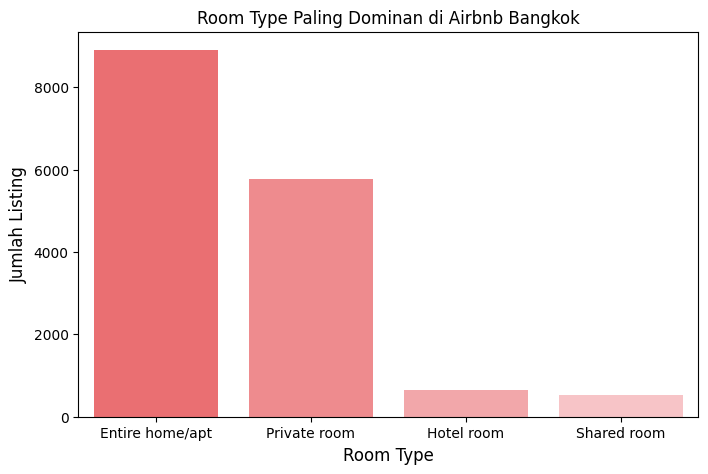

In [41]:
# palet Rausch
rausch = ['#FF5A5F', '#FF7A7E', '#FF9A9F', '#FFBBBF']

plt.figure(figsize=(8, 5))
sns.countplot(
    data=df,
    x='room_type',
    order=df['room_type'].value_counts().index,
    palette=rausch
)
plt.title('Room Type Paling Dominan di Airbnb Bangkok')
plt.xlabel('Room Type', fontsize=12)
plt.ylabel('Jumlah Listing', fontsize=12)
plt.show()

**Insight :**
- Entire home/apt terlihat jauh lebih tinggi jumlah listingnya dibandingkan 3 tipe lainnya.
- Berdasarkan praktik umum di pasar Airbnb, sewa satu unit penuh (Entire home/apt) adalah jenis paling populer secara global, karena menawarkan:
    - Privasi penuh
    - Fleksibilitas waktu
    - Cocok untuk keluarga atau grup
- Shared room dan Hotel room cenderung:
    - Dipilih oleh budget travelers.
    - Kurang populer jika dibandingkan dengan privasi yang ditawarkan oleh unit full.

Setelah mengetahui tipe kamar yang paling banyak ditemukan, selanjutnya melihat di mana lokasi atau neighborhood dengan jumlah listing terbanyak, untuk memahami kawasan mana yang paling kompetitif di pasar.

## 2. Neighborhood Terbanyak
Perlu mengetahui daerah mana yang memiliki listing terbanyak. Analisis ini membantu kita memahami apakah lokasi berperan besar dalam menentukan jumlah listing Airbnb.

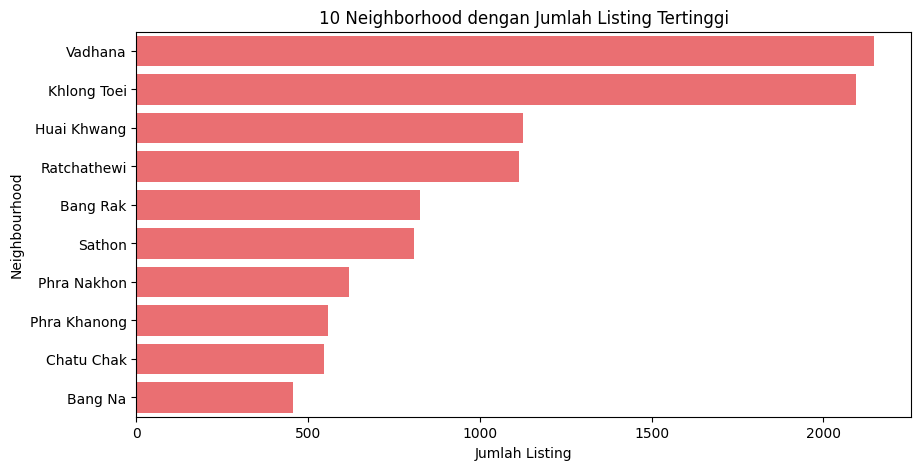

In [42]:
# Memeriksa 10 neighbourhood dengan jumlah listing terbanyak
top_neigh = df['neighbourhood'].value_counts().head(10)

# Visualisasi menggunakan barplot
plt.figure(figsize=(10, 5))
sns.barplot(x=top_neigh.values, y=top_neigh.index, color='#FF5A5F')
plt.title('10 Neighborhood dengan Jumlah Listing Tertinggi')
plt.xlabel('Jumlah Listing')
plt.ylabel('Neighbourhood')
plt.show()

**Insight :**
- Vadhana dan Khlong Toei menempati posisi teratas, masing-masing dengan lebih dari 2.000 listing.
- Tingginya jumlah listing di beberapa neighborhood dapat mengindikasikan:
    - Konsentrasi supply yang lebih tinggi.
    - Potensi kompetisi antar host yang lebih ketat di area tersebut.

Namun, mengetahui hanya jumlah listing belum cukup untuk memberi gambaran menyeluruh. Oleh karena itu, perlu mengkaji lebih dalam apakah ada keterkaitan antara tipe kamar yang dominan dengan lokasi tertentu. Dengan kata lain, tipe kamar tertentu mungkin lebih populer di neighborhood tertentu.

## 3. Tipe Host Terbanyak (Pie Chart)
Analisis ini bertujuan untuk memahami distribusi antara host profesional dan host non-profesional. Host profesional biasanya memiliki lebih dari satu listing, sementara host non-profesional hanya memiliki satu listing.

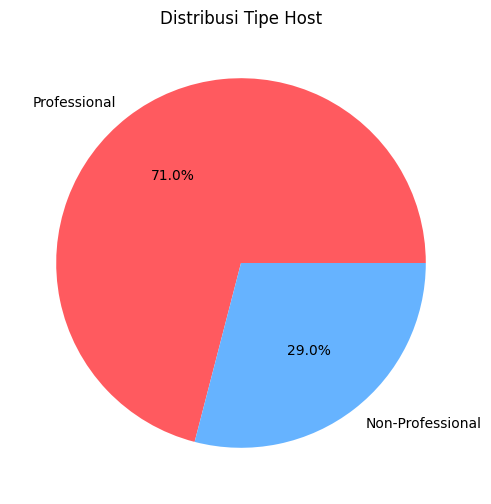

In [43]:
# Menghitung distribusi tipe host
host_type_counts = df['host_type'].value_counts()

# Menampilkan hasil dalam pie chart
host_type_counts.plot(kind='pie', autopct='%1.1f%%', figsize=(8, 6), colors=['#FF5A5F', '#66b3ff'])
plt.title('Distribusi Tipe Host')
plt.ylabel('')  # Menghapus label di sumbu y
plt.show()

**Insight :**
- Terlihat bahwa 71% dari total host adalah host profesional. Ini menunjukkan bahwa mayoritas host di Airbnb Bangkok mengelola lebih dari satu listing, yang mungkin menunjukkan mereka lebih berpengalaman atau mengelola beberapa properti untuk menyewakan.
- Sementara itu, hanya 29% dari host yang tergolong non-profesional, yang berarti mereka hanya memiliki satu listing. Ini mengindikasikan bahwa segmen host yang lebih kecil mengelola listing individu dan mungkin lebih bersifat pribadi.

## 4. Distribusi Harga
Menampilkan distribusi harga untuk mengetahui bagaimana harga tersebar di seluruh listing. Ini akan menunjukkan apakah sebagian besar listing memiliki harga yang rendah atau tinggi, serta melihat adanya outliers (nilai ekstrem).

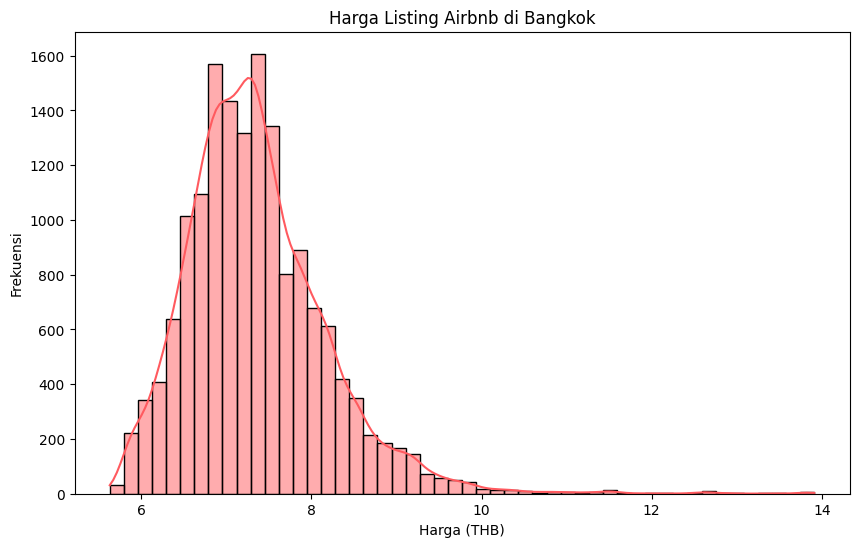

In [44]:
# Menampilkan distribusi harga dengan log scale
plt.figure(figsize=(10, 6))
sns.histplot(np.log1p(df['price']), bins=50, color='#FF5A5F', kde=True)  # Menggunakan log1p untuk log(harga+1)
plt.title('Harga Listing Airbnb di Bangkok')
plt.xlabel('Harga (THB)')
plt.ylabel('Frekuensi')
plt.show()

**Insight:**
- Right skewed
- Tampak bahwa sebagian besar listing memiliki harga yang relatif terjangkau, dengan konsentrasi harga berada di sekitar skala logaritmik 6 hingga 8 (harga sekitar 400 hingga 2,000 THB). Ini menunjukkan bahwa mayoritas listing cenderung berada dalam rentang harga yang lebih rendah.
- Ada beberapa puncak harga yang menunjukkan adanya kelompok listing yang sering muncul dalam rentang harga menengah. Ini bisa mengindikasikan bahwa harga menengah lebih disukai oleh banyak host dan tamu.

## 5. Distribusi Minimum Nights
Distribusi minimum_nights memberikan gambaran tentang durasi menginap yang ditetapkan oleh host. Ini bisa memberi wawasan apakah banyak listing yang membatasi durasi penginapan untuk waktu yang sangat singkat, atau apakah ada yang memiliki durasi penginapan yang sangat panjang.

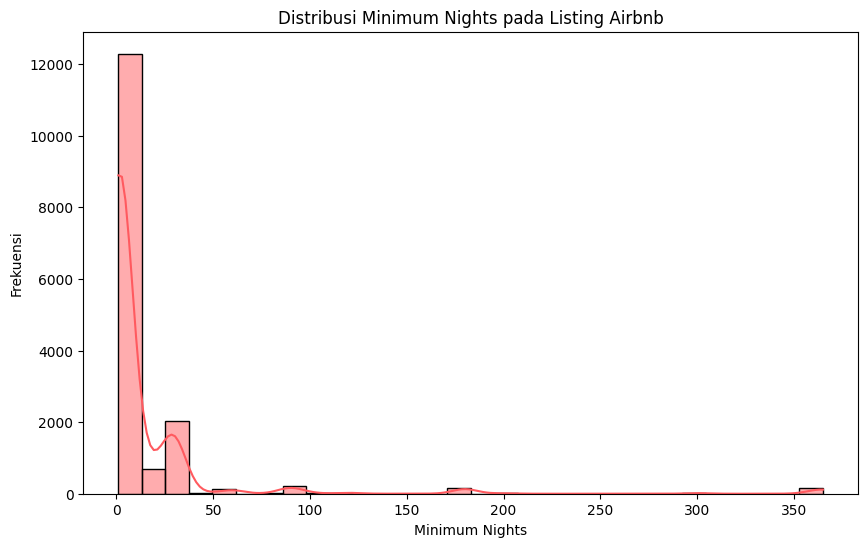

In [45]:
# Menampilkan distribusi minimum nights dengan histogram
plt.figure(figsize=(10, 6))
sns.histplot(df['minimum_nights'], bins=30, color='#FF5A5F', kde=True)
plt.title('Distribusi Minimum Nights pada Listing Airbnb')
plt.xlabel('Minimum Nights')
plt.ylabel('Frekuensi')
plt.show()

**Insight:**
- Right skewed
- Kebanyakan listing di Airbnb cenderung menetapkan durasi menginap yang sangat pendek (1 malam). Ini menunjukkan bahwa mayoritas tamu lebih suka menginap dalam waktu singkat, misalnya untuk perjalanan singkat atau liburan.
- Host yang menetapkan durasi panjang mungkin ingin menarik tamu untuk tinggal lebih lama (misalnya, ekspatriat, pelancong jangka panjang), meskipun jumlah listing dengan durasi seperti itu sangat sedikit.

## 6. Rating Ulasan yang Mempengaruhi Pendapatan
Listing dengan rating tinggi mungkin lebih sering dipesan, sehingga mempengaruhi pendapatan dan popularitas.

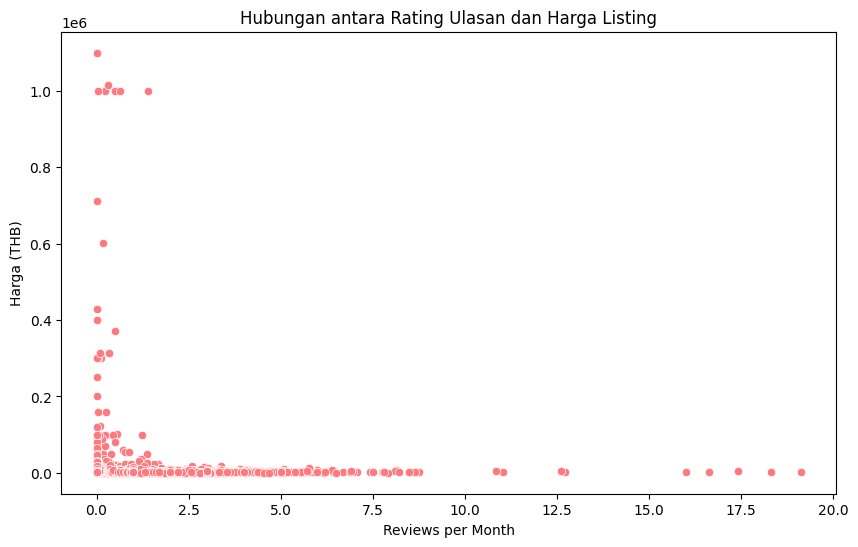

In [46]:
# Menampilkan hubungan antara rating ulasan dan harga dengan scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['reviews_per_month'], y=df['price'], color='#FF7A7E') 
plt.title('Hubungan antara Rating Ulasan dan Harga Listing')
plt.xlabel('Reviews per Month')
plt.ylabel('Harga (THB)')
plt.show()

**Insight:**
- Sebagian besar data berada di bagian bawah scatter plot, yang menunjukkan bahwa kebanyakan listing memiliki harga rendah (di bawah 200,000 THB) dan jumlah ulasan per bulan yang juga lebih sedikit.
- Dari visualisasi ini, terlihat bahwa tidak ada pola jelas yang menunjukkan bahwa harga lebih tinggi berhubungan dengan lebih banyak ulasan.
- Terdapat beberapa outliers yang menunjukkan listing dengan harga sangat tinggi tetapi jumlah ulasan yang sangat rendah. Ini bisa menunjukkan properti yang sangat eksklusif, mungkin jenis vila atau tempat tinggal mewah yang jarang disewa tetapi memiliki harga sangat tinggi.

Spearman's Rank Correlation digunakan untuk mengukur hubungan monotonik antara dua variabel ordinal atau kontinu. Uji ini berguna saat data tidak terdistribusi normal.

**Hipotesis:**
- H0: Tidak ada hubungan yang signifikan antara rating ulasan dan pendapatan
- H1: Ada hubungan yang signifikan antara rating ulasan dan pendapatan

In [47]:
from scipy.stats import spearmanr

rho, p_value = spearmanr(df['reviews_per_month'], df['price'])

rho

np.float64(0.017104075344153223)

**Kesimpulan secara sampel:** Meskipun ada hubungan antara jumlah ulasan dan harga listing, kekuatan hubungan tersebut sangat lemah.

In [48]:
# interpretasi hasil:
if p_value > 0.05:
    print(f'p_value = {p_value:.2f}, Tidak ada hubungan')
else:
    print(f'p_value = {p_value:.2f}, Ada hubungan')

p_value = 0.03, Ada hubungan


**Kesimpulan secara populasinya:** Secara keseluruhan, meskipun hubungan tersebut signifikan, hubungan antara jumlah ulasan dan harga listing sangat lemah. Artinya, ada sedikit bukti untuk mendukung bahwa rating ulasan secara langsung mempengaruhi harga listing di Airbnb.

Walaupun hubungan signifikan ditemukan, hubungan yang lemah menunjukkan bahwa faktor-faktor lain lebih berperan dalam menentukan harga listing. Untuk host yang ingin meningkatkan harga mereka, fokus pada faktor lain (seperti kualitas foto, deskripsi yang lebih baik, fasilitas, dll.) mungkin lebih efektif daripada hanya bergantung pada jumlah ulasan.

## 7. Persebaran Listing Airbnb di Bangkok Berdasarkan Harga, Jumlah Ulasan, dan Tingkat Ketersediaan
Untuk memahami faktor-faktor yang memengaruhi performa listing, penting untuk menganalisis bagaimana harga, jumlah ulasan, dan tingkat ketersediaan berhubungan dengan lokasi geografis di Bangkok. Peta persebaran ini menggabungkan ketiga variabel tersebut dengan menggunakan warna untuk harga, ukuran bubble untuk jumlah ulasan, dan tingkat transparansi untuk tingkat ketersediaan. Visualisasi ini membantu mengidentifikasi area dengan harga lebih tinggi atau lebih rendah, serta melihat hubungan antara popularitas dan pendapatan berdasarkan lokasi geografis.

In [49]:
import folium
from folium.plugins import MarkerCluster
import branca

# Membuat peta dasar dengan style CartoDB Positron
map_bangkok = folium.Map(location=[13.7563, 100.5018], zoom_start=12, 
                         tiles='CartoDB positron', 
                         attr='Map tiles by CartoDB, under CC BY 3.0. Data by OpenStreetMap, under ODbL.')

# Membuat kolormap untuk neighborhood (50 warna berbeda)
colors = branca.colormap.StepColormap(['#FF0000', '#FF7F00', '#FFFF00', '#7FFF00', '#00FF00', '#00FF7F', '#00FFFF', '#007FFF', '#0000FF', '#7F00FF', 
                                      '#FF00FF', '#FF007F', '#FF5555', '#FFAA00', '#FFFF55', '#A0FF00', '#00FFAA', '#00A0FF', '#5555FF', '#AA00FF',
                                      '#FF5500', '#FFAA55', '#AAFF00', '#00FF55', '#00AAFF', '#55FF00', '#FF00AA', '#FF5500', '#FFAA00', '#A0FF55', 
                                      '#00FF55', '#AAFF00', '#FF55FF', '#00AAFF', '#FF00FF', '#FFAA00', '#FF5500', '#A0FF00', '#FF5555', '#FF00AA', 
                                      '#FF0000', '#FF7F00', '#FF0000', '#FF7F00', '#FFFF00', '#7FFF00', '#00FF00', '#FF7F00', '#0000FF', '#FF0000'], 
                          vmin=0, vmax=50, caption='Neighborhood')

# Menambahkan MarkerCluster untuk menandai lokasi listing
marker_cluster = MarkerCluster().add_to(map_bangkok)

# Menambahkan marker untuk setiap listing di dataframe
for i, row in df.iterrows():
    # Menentukan warna berdasarkan harga
    price_color = 'green' if row['price'] < 1000 else 'orange' if row['price'] < 5000 else 'red'
    
    # Menentukan ukuran bubble berdasarkan jumlah ulasan
    review_size = 5 + (row['number_of_reviews'] / 10)  # ukuran bubble berdasarkan ulasan
    
    # Menentukan opacity berdasarkan tingkat okupansi (availability_365)
    availability_opacity = 0.3 + (row['availability_365'] / 365) * 0.7  # opacity berdasarkan tingkat ketersediaan
    
    # Menambahkan marker ke peta
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=review_size,
        color=price_color,
        fill=True,
        fill_color=price_color,
        fill_opacity=availability_opacity,
        popup=f"Neighbourhood: {row['neighbourhood']}<br>Price: {row['price']} THB<br>Reviews: {row['number_of_reviews']}<br>Availability: {row['availability_365']} days"
    ).add_to(marker_cluster)

# Choropleth: Menambahkan polygon berdasarkan neighbourhood
geojson_url = 'https://raw.githubusercontent.com/Quinntes/airbnb_listings_bangkok/main/bangkok-districts.geojson'
folium.Choropleth(
    geo_data=geojson_url,
    name='Neighborhoods',
    data=df,
    columns=['neighbourhood', 'price'],
    key_on='feature.properties.dname_e',
    fill_color='YlGnBu',  # Color scale, change as needed
    fill_opacity=0.5,
    line_opacity=0.2,
    legend_name='Average Price',
).add_to(map_bangkok)

# Menambahkan control layer untuk peta choropleth
folium.LayerControl().add_to(map_bangkok)

# Menampilkan peta interaktif
map_bangkok

## 8. Perbandingan Harga per Jenis Kamar
Membandingkan harga untuk jenis kamar yang berbeda dan memahami bagaimana harga dapat memengaruhi pendapatan.

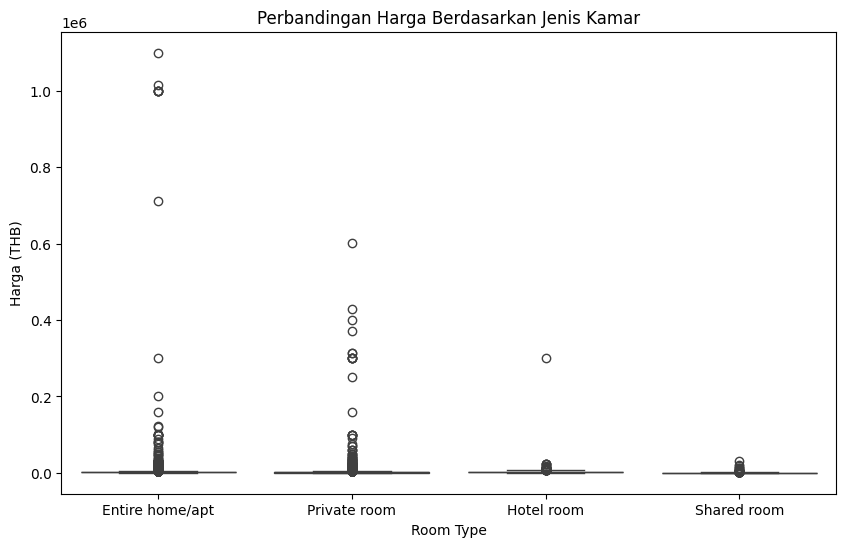

In [50]:
# Menampilkan perbandingan harga berdasarkan room_type dengan boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=df['room_type'], y=df['price'])
plt.title('Perbandingan Harga Berdasarkan Jenis Kamar')
plt.xlabel('Room Type')
plt.ylabel('Harga (THB)')
plt.show()

**Insight:**
- Harga rata-rata untuk Entire home/apt jauh lebih tinggi dibandingkan dengan jenis kamar lainnya, dengan beberapa outliers ekstrem yang menunjukkan harga yang sangat tinggi (lebih dari 600,000 THB). Ini menunjukkan bahwa beberapa listing Entire home/apt adalah properti yang sangat besar atau mewah dengan harga yang sangat tinggi.
- Private room memiliki harga yang jauh lebih rendah dibandingkan dengan Entire home/apt. Tidak ada outliers yang ekstrem pada jenis kamar ini, dan harga terlihat lebih terpusat di sekitar nilai rendah hingga sedang.
- Hotel room dan Shared room memiliki harga yang sangat mirip dan relatif lebih rendah dibandingkan Entire home/apt dan Private room.

## 9. Performa Listing
Selanjutnya akan fokus pada performa listing berdasarkan `room_type` dengan melihat jumlah ulasan dan okupansi (availability) untuk setiap jenis kamar. Ini akan membantu untuk mengetahui jenis kamar mana yang memiliki performa terbaik dan apakah harga berhubungan dengan lebih banyak ulasan atau lebih banyak okupansi.

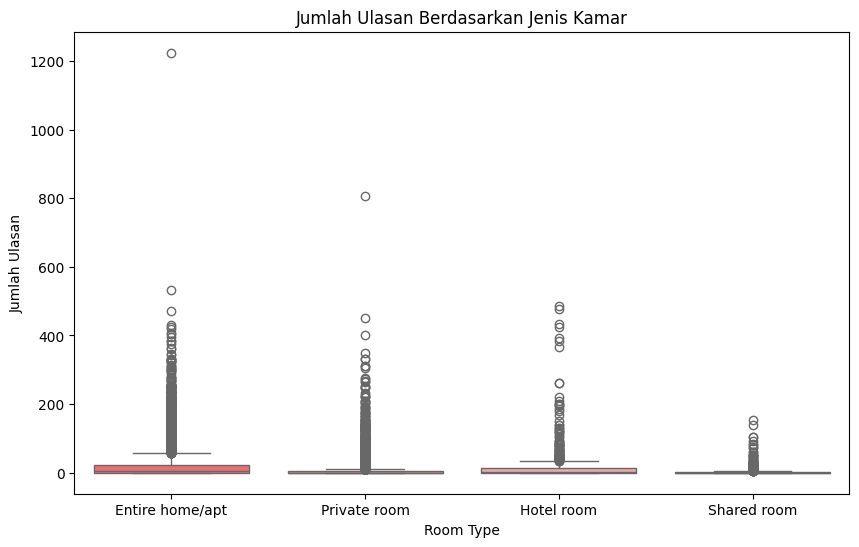

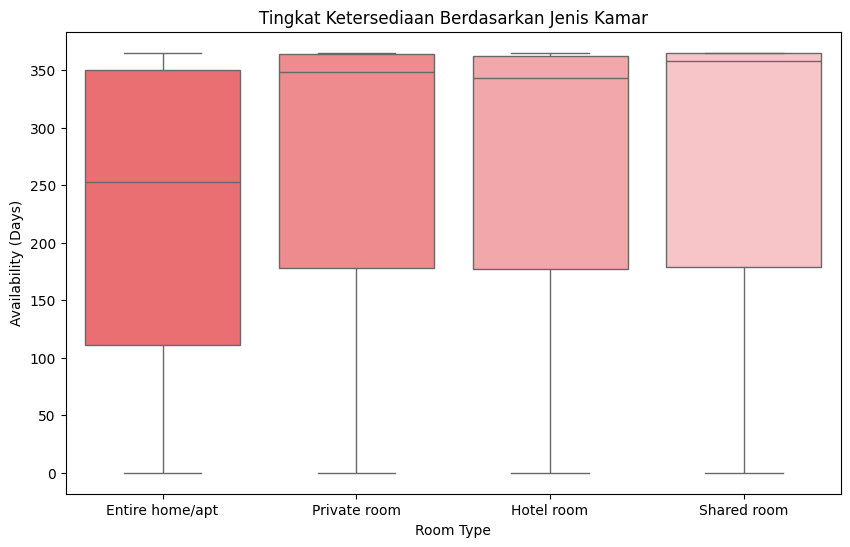

In [51]:
# Menampilkan perbandingan jumlah ulasan berdasarkan room_type dengan boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=df['room_type'], y=df['number_of_reviews'], palette=rausch)
plt.title('Jumlah Ulasan Berdasarkan Jenis Kamar')
plt.xlabel('Room Type')
plt.ylabel('Jumlah Ulasan')
plt.show()

# Menampilkan perbandingan tingkat ketersediaan (availability) berdasarkan room_type dengan boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x=df['room_type'], y=df['availability_365'], palette=rausch)
plt.title('Tingkat Ketersediaan Berdasarkan Jenis Kamar')
plt.xlabel('Room Type')
plt.ylabel('Availability (Days)')
plt.show()

**Insight:**
- Entire home/apt cenderung memiliki jumlah ulasan yang lebih tinggi dan ketersediaan yang lebih rendah. Ini menunjukkan bahwa properti ini lebih besar dan lebih jarang tersedia (mungkin disewa lebih lama oleh tamu).
- Private room menunjukkan performa yang stabil dengan jumlah ulasan dan ketersediaan yang cukup tinggi. Ini adalah pilihan populer untuk tamu yang mencari privasi dengan harga lebih terjangkau.
- Hotel room dan Shared room menunjukkan ketersediaan yang lebih tinggi, tetapi dengan jumlah ulasan yang lebih sedikit. Ini mungkin karena Hotel room lebih sering dipesan untuk jangka pendek dan Shared room lebih terjangkau, tetapi lebih sedikit ulasan karena tamu yang menginap lebih cepat atau hanya menginap untuk beberapa malam.

## 10. Hubungan Antara Harga dan Jumlah Ulasan
Menganalisis apakah harga yang lebih tinggi berhubungan dengan jumlah ulasan yang lebih banyak. Ini bisa memberikan wawasan apakah listing dengan harga lebih tinggi cenderung lebih populer dan lebih sering mendapatkan ulasan.

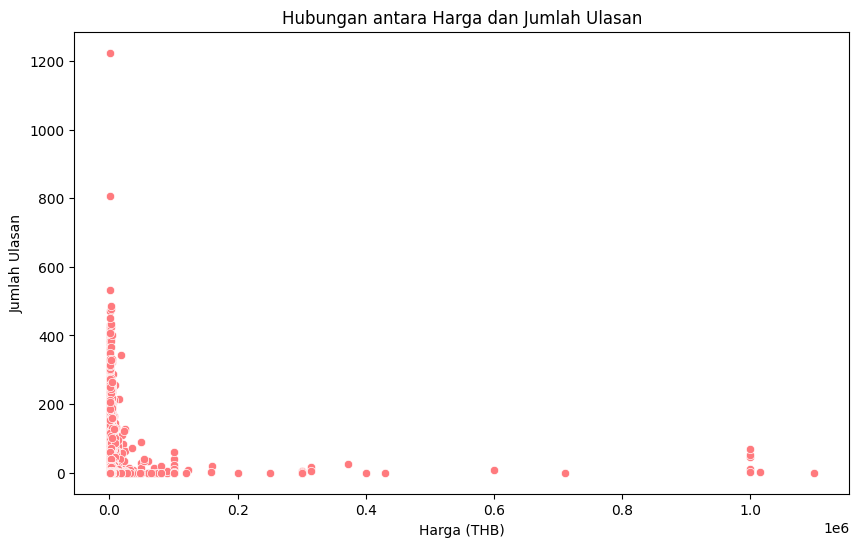

In [52]:
# Menampilkan hubungan antara harga dan jumlah ulasan dengan scatter plot
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['price'], y=df['number_of_reviews'], color='#FF7A7E')
plt.title('Hubungan antara Harga dan Jumlah Ulasan')
plt.xlabel('Harga (THB)')
plt.ylabel('Jumlah Ulasan')
plt.show()

**Insight:**
- Mayoritas data terletak di sisi kiri bawah plot, di mana harga rendah (di bawah 200k THB) dan jumlah ulasan rendah. Ini menunjukkan bahwa sebagian besar listing memiliki harga yang terjangkau dan jumlah ulasan yang relatif sedikit.
- Beberapa titik data yang terletak di kanan atas (harga tinggi) memiliki jumlah ulasan yang sangat tinggi (lebih dari 500 ulasan). Ini menunjukkan bahwa meskipun harga sangat tinggi, beberapa listing dengan harga tersebut mendapatkan banyak ulasan.
- Dari visualisasi ini, tampak bahwa harga yang lebih tinggi tidak selalu berhubungan dengan lebih banyak ulasan. Meskipun ada beberapa listing yang memiliki harga tinggi dan banyak ulasan, sebagian besar listing dengan harga tinggi tidak memiliki banyak ulasan, sementara banyak listing dengan harga rendah mendapat sedikit ulasan.

**Hipotesis:**
- H0: Tidak ada hubungan yang signifikan antara harga dan jumlah ulasan.
- H1: Ada hubungan yang signifikan antara harga dan jumlah ulasan.

In [53]:
from scipy.stats import spearmanr

rho, p_value = spearmanr(df['price'], df['number_of_reviews'])

rho

np.float64(-0.020952845531627122)

**Kesimpulan secara sampel:** Nilai koefisien korelasi yang sangat kecil dan negatif menunjukkan bahwa hubungan antara harga dan jumlah ulasan sangat lemah dan negatif. Artinya, semakin tinggi harga, tidak ada hubungan yang jelas apakah jumlah ulasan akan bertambah atau berkurang.

In [54]:
# interpretasi hasil:
if p_value > 0.05:
    print(f'p_value = {p_value:.2f}, Tidak ada hubungan')
else:
    print(f'p_value = {p_value:.2f}, Ada hubungan')

p_value = 0.01, Ada hubungan


**Kesimpulan secara populasinya:** Secara statistik, kita bisa menyimpulkan bahwa ada hubungan signifikan antara harga dan jumlah ulasan.

Ada hubungan signifikan, tetapi sangat lemah antara harga dan jumlah ulasan. Ini berarti bahwa walaupun harga mungkin sedikit mempengaruhi ulasan, faktor lain (seperti lokasi, kualitas pelayanan, dan fasilitas) kemungkinan besar lebih penting dalam mempengaruhi jumlah ulasan daripada harga.

## 11. Hubungan Antara Harga dan Tingkat Ketersediaan 
Menilai hubungan antara harga dan tingkat ketersediaan untuk melihat apakah harga tinggi lebih sering diikuti dengan okupansi lebih rendah, yang dapat mempengaruhi pendapatan.

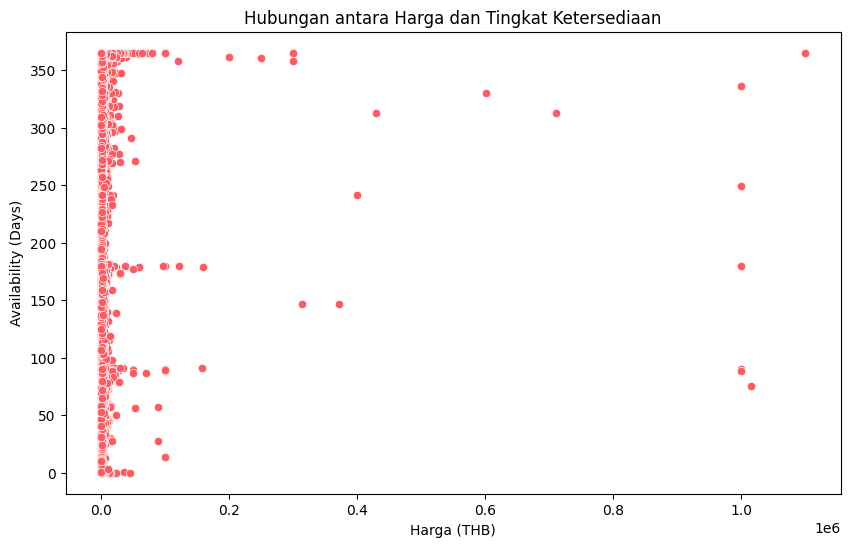

In [55]:
# Scatter plot antara harga dan tingkat ketersediaan
plt.figure(figsize=(10, 6))
sns.scatterplot(x=df['price'], y=df['availability_365'], color='#FF5A5F')
plt.title('Hubungan antara Harga dan Tingkat Ketersediaan')
plt.xlabel('Harga (THB)')
plt.ylabel('Availability (Days)')
plt.show()

**Insight:**
- Harga yang lebih tinggi tidak selalu berhubungan dengan ketersediaan yang lebih rendah. Meskipun ada beberapa listing dengan harga tinggi dan ketersediaan rendah, ini tidak berlaku untuk semua listing. Banyak listing dengan harga rendah tetap memiliki ketersediaan yang tinggi.
- Listing dengan harga rendah cenderung lebih sering tersedia, tetapi harga yang tinggi mungkin menunjukkan properti yang lebih jarang disewa atau hanya disewa untuk jangka waktu yang lebih lama.

**Hipotesis:**
- H0: Tidak ada hubungan yang signifikan antara harga dan tingkat ketersediaan.
- H1: Ada hubungan yang signifikan antara harga dan tingkat ketersediaan.

In [56]:
from scipy.stats import spearmanr

rho, p_value = spearmanr(df['price'], df['availability_365'])

rho

np.float64(-0.00019408708633845203)

**Kesimpulan secara sampel:** Hasil uji statistik menunjukkan bahwa ada hubungan yang sangat lemah dan tidak signifikan antara harga dan tingkat ketersediaan. Korelasi yang ditemukan sangat kecil dan mendekati nol, yang menunjukkan bahwa harga dan tingkat ketersediaan tidak saling memengaruhi.

In [57]:
# interpretasi hasil:
if p_value > 0.05:
    print(f'p_value = {p_value:.2f}, Tidak ada hubungan')
else:
    print(f'p_value = {p_value:.2f}, Ada hubungan')

p_value = 0.98, Tidak ada hubungan


**Kesimpulan secara populasinya:** Secara keseluruhan, dapat disimpulkan bahwa harga dan tingkat ketersediaan tidak memiliki hubungan signifikan dalam populasi yang lebih besar. Walaupun ada korelasi negatif yang sangat kecil, hubungan tersebut tidak cukup kuat atau signifikan untuk memberikan wawasan yang berarti.

Tidak ada hubungan yang signifikan antara harga dan tingkat ketersediaan. Ini berarti bahwa harga yang lebih tinggi tidak secara langsung memengaruhi berapa lama listing tersedia untuk disewa dalam setahun. Banyak faktor lain selain harga yang bisa memengaruhi ketersediaan, seperti jenis kamar, lokasi, dan kebijakan pengelola properti.

## 12. Segmentasi Pasar Berdasarkan Harga (Low Price vs High Price)
Menilai perbedaan performa antara segmentasi harga rendah dan harga tinggi. Membandingkan pendapatan, okupansi, dan jumlah ulasan berdasarkan kategori harga dapat memberi wawasan tentang strategi harga yang optimal.

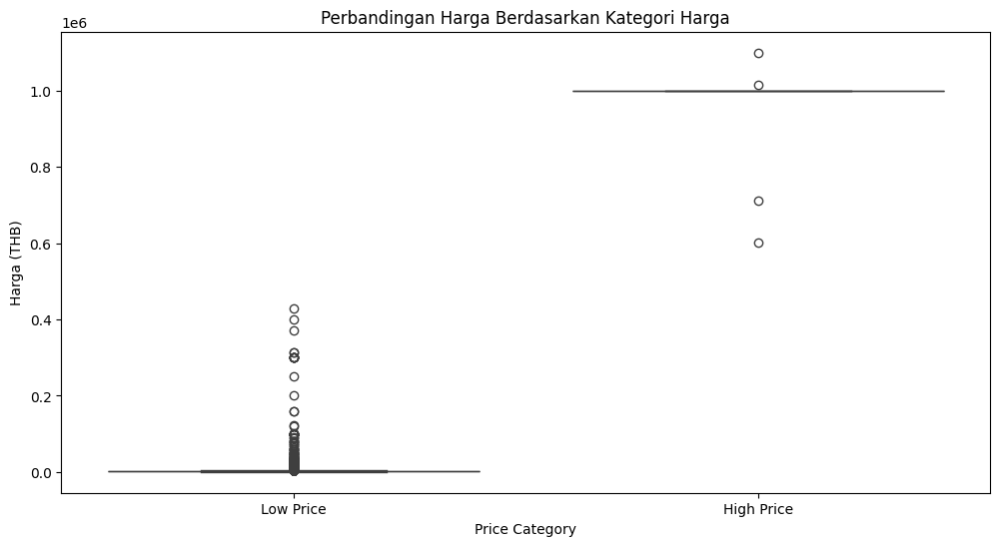

price_category
Low Price     244.398825
High Price    225.111111
Name: availability_365, dtype: float64

In [58]:
# Boxplot per kategori harga
plt.figure(figsize=(12, 6))
sns.boxplot(x=df['price_category'], y=df['price'])
plt.title('Perbandingan Harga Berdasarkan Kategori Harga')
plt.xlabel('Price Category')
plt.ylabel('Harga (THB)')
plt.show()

# Membandingkan performa berdasarkan kategori harga
df.groupby('price_category')['number_of_reviews'].mean()
df.groupby('price_category')['availability_365'].mean()

**Insight:**
- Listing dengan harga rendah cenderung lebih sering tersedia (lebih banyak hari dalam setahun tersedia), tetapi mungkin memiliki harga lebih terjangkau.
- Listing dengan harga tinggi cenderung lebih jarang tersedia, meskipun mereka memiliki harga lebih tinggi. Ini bisa menunjukkan bahwa harga tinggi cenderung berhubungan dengan okupansi lebih rendah atau hanya tersedia untuk penginapan jangka panjang atau tamu tertentu yang menginginkan properti eksklusif.

## 13. Korelasi antara Harga, Ulasan, dan Okupansi
Mengidentifikasi korelasi antara harga, jumlah ulasan, dan tingkat ketersediaan untuk mengetahui apakah ada hubungan signifikan yang dapat memengaruhi pendapatan dan popularitas.

**Hipotesis:**
- H0: Tidak ada hubungan yang signifikan antara harga, jumlah ulasan, dan tingkat okupansi.
- H1: Ada hubungan yang signifikan antara harga, jumlah ulasan, dan tingkat okupansi.

In [59]:
from scipy.stats import spearmanr

In [60]:
num_columns = ['price', 'number_of_reviews', 'reviews_per_month', 'availability_365']

In [61]:
# hitung korelasi
corr = df[num_columns].corr(method = 'spearman') ## defaultnya itu pearson jadi kalo datanya tidak normal harus ditambahkan spearman 
corr

,price,number_of_reviews,reviews_per_month,availability_365
price,1.000000,-0.020953,0.017104,-0.000194
number_of_reviews,-0.020953,1.000000,0.891872,-0.264409
reviews_per_month,0.017104,0.891872,1.000000,-0.252098
availability_365,-0.000194,-0.264409,-0.252098,1.000000


**Kesimpulan:** Berdasarkan p-value yang sangat besar dan korelasi yang sangat kecil, gagal menolak H0, yang berarti tidak ada hubungan yang signifikan antara harga, jumlah ulasan, dan tingkat ketersediaan.

<Axes: >

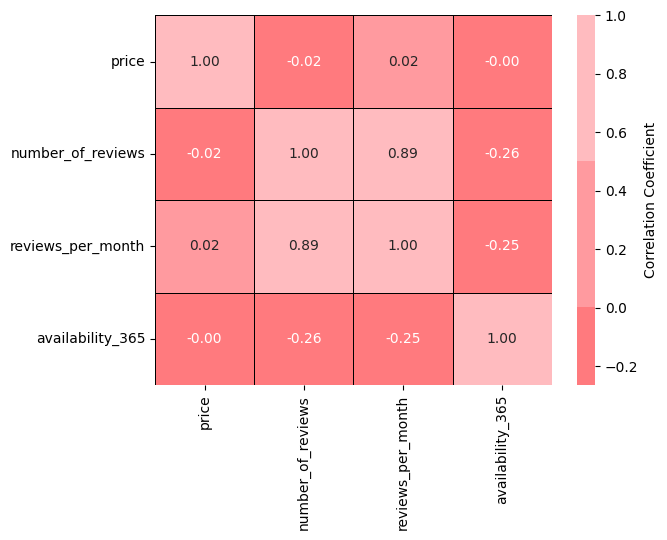

In [62]:
# heatmap korelasi
sns.heatmap(corr, annot=True, fmt='.2f', cmap=sns.color_palette(rausch, as_cmap=True), 
            linewidths=0.5, linecolor='black', cbar_kws={'label': 'Correlation Coefficient'}, center=0)

**Insight:**
- Seperti yang terlihat pada heatmap, harga tidak memiliki korelasi yang kuat dengan jumlah ulasan atau ulasan per bulan. Oleh karena itu, harga tinggi tidak selalu berhubungan dengan lebih banyak ulasan.
- Jumlah ulasan dan ulasan per bulan menunjukkan korelasi positif yang kuat (0.89). Ini menunjukkan bahwa listing yang lebih sering disewa atau yang lebih sering mendapatkan ulasan bulanan biasanya memiliki jumlah ulasan yang lebih tinggi.

## 14. Perbandingan Okupansi berdasarkan Lokasi dengan Mempertimbangkan Harga
Analisis ini bertujuan untuk membandingkan okupansi ()`availability_365`) berdasarkan lokasi (`neighbourhood`) dengan mempertimbangkan `price`. Apakah neighbourhood cenderung lebih sering terisi meskipun memiliki harga lebih tinggi dibandingkan dengan neighbourhood dengan harga rendah.

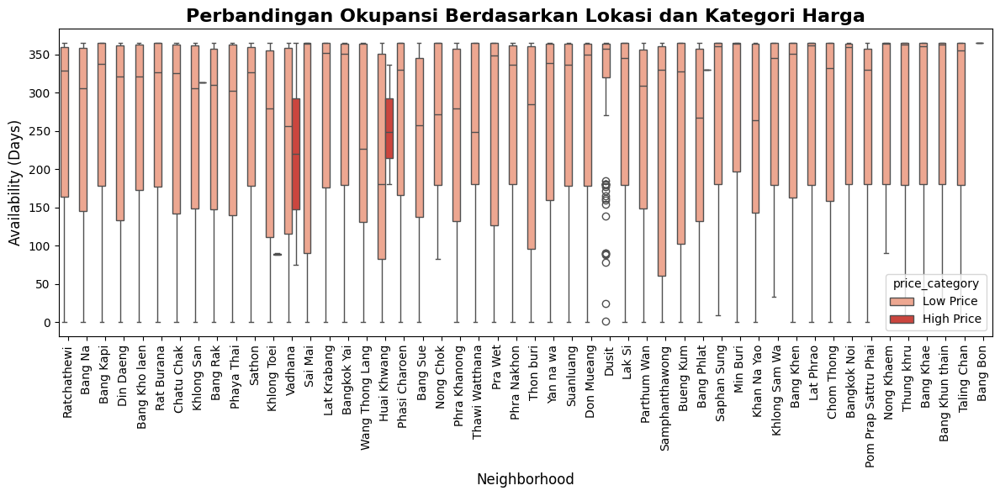

In [63]:
# Membuat boxplot perbandingan okupansi berdasarkan lokasi dan kategori harga dengan warna biru dan merah
plt.figure(figsize=(12, 6))
sns.boxplot(x='neighbourhood', y='availability_365', hue='price_category', data=df, palette='Reds')
plt.title('Perbandingan Okupansi Berdasarkan Lokasi dan Kategori Harga', fontsize=16, fontweight='bold')
plt.xlabel('Neighborhood', fontsize=12)
plt.ylabel('Availability (Days)', fontsize=12)
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

**Insight:**
- Neighbourhood premium yang lebih mahal tidak selalu berarti lebih sedikit okupansi. Meskipun harga lebih tinggi, lokasi-lokasi ini masih memiliki tingkat okupansi yang cukup tinggi.
- Neighbourhood dengan harga rendah lebih sering terisi, meskipun properti di lokasi ini mungkin memiliki harga yang lebih rendah dan lebih terjangkau.

## 15. Harga dan Ulasan per Bulan Berdasarkan Ada/Tidaknya Ulasan
Grafik ini memberikan gambaran tentang harga listing dan jumlah ulasan per bulan berdasarkan ada atau tidaknya ulasan. Ini membantu untuk memahami apakah harga yang lebih tinggi cenderung lebih banyak ulasan, atau apakah listing yang lebih terjangkau memiliki lebih banyak ulasan dalam periode waktu tertentu.

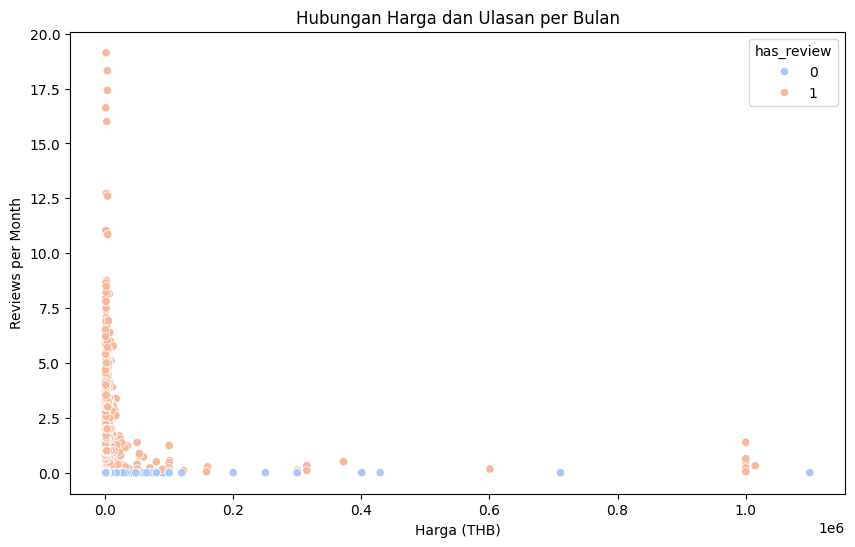

In [64]:
plt.figure(figsize=(10, 6))
sns.scatterplot(x='price', y='reviews_per_month', hue='has_review', data=df, palette='coolwarm')
plt.title('Hubungan Harga dan Ulasan per Bulan')
plt.xlabel('Harga (THB)')
plt.ylabel('Reviews per Month')
plt.show()

**Insight:**
- Listing Tanpa Ulasan:
  - Terlihat bahwa listing yang tidak memiliki ulasan umumnya cenderung memiliki harga yang lebih rendah, dengan sebagian besar listing memiliki sangat sedikit ulasan per bulan.
  - Hanya ada beberapa listing dengan harga sangat tinggi (outliers), namun jumlah ulasannya tetap sangat rendah, menunjukkan bahwa meskipun harga tinggi, mereka kurang menarik perhatian tamu untuk memberikan ulasan.

- Listing dengan Ulasan:
  - Listing yang memiliki ulasan cenderung menunjukkan harga yang lebih bervariasi, tetapi lebih banyak dari mereka memiliki jumlah ulasan per bulan yang lebih tinggi.
  - Beberapa listing dengan harga lebih rendah memiliki ulasan per bulan yang lebih banyak, yang menunjukkan bahwa harga yang lebih terjangkau cenderung lebih sering disewa, menghasilkan lebih banyak ulasan.

**Hipotesis:**
- H0: Tidak ada perbedaan yang signifikan antara harga listing yang memiliki ulasan dan yang tidak memiliki ulasan.
- H1: Ada perbedaan yang signifikan antara harga listing yang memiliki ulasan dan yang tidak memiliki ulasan.

In [65]:
with_reviews = df[df['has_review'] == 1]['price']
without_reviews = df[df['has_review'] == 0]['price']

In [66]:
from scipy.stats import mannwhitneyu

# uji statistik (2 tail)
stats, p_value = mannwhitneyu(with_reviews, without_reviews)

# interpretasi hasil:
if p_value > 0.05:
    print(f'p_value = {p_value:.2f}, Terima H0')
else:
    print(f'p_value = {p_value:.2f}, Terima H1')

p_value = 0.00, Terima H1


**Kesimpulan:** Ada perbedaan yang signifikan antara harga listing yang memiliki ulasan dan yang tidak memiliki ulasan.

Secara praktis, hasil ini menunjukkan bahwa harga listing yang memiliki ulasan cenderung berbeda secara signifikan dibandingkan dengan harga listing yang tidak memiliki ulasan. Hasil ini bisa memberikan wawasan bahwa ulasan mungkin berhubungan dengan harga, atau harga yang lebih tinggi mungkin dikaitkan dengan listing yang lebih jarang disewa (yang tidak memiliki ulasan), sementara listing yang lebih terjangkau dan sering disewa mungkin mendapatkan lebih banyak ulasan.

## 16. Pengaruh Jarak ke Tempat Wisata Terhadap Harga dan Performa Listing di Airbnb Bangkok
Apakah lokasi geografis berperan penting dalam menentukan harga dan performa listing di Airbnb di Bangkok. Dengan menganalisis jarak ke atraksi wisata utama, seperti Grand Palace, Khao San Road, dan Terminal 21, kita akan melihat apakah properti yang lebih dekat dengan tempat-tempat wisata tersebut cenderung memiliki harga lebih tinggi, lebih sering disewa, atau memiliki tingkat ketersediaan yang lebih rendah. Melalui analisis ini, kita dapat memahami apakah kedekatan lokasi dengan atraksi populer di Bangkok memberikan keuntungan kompetitif bagi host dalam menentukan harga dan tingkat okupansi.

In [67]:
import geopy.distance

# Koordinat Atraksi Wisata
grand_palace = (13.7490, 100.4914)
khao_san_road = (13.7461, 100.4975)
terminal_21 = (13.7363, 100.5592)

# Fungsi untuk menghitung jarak Haversine
def calculate_distance(lat1, lon1, lat2, lon2):
    coords_1 = (lat1, lon1)
    coords_2 = (lat2, lon2)
    return geopy.distance.distance(coords_1, coords_2).km

# Menghitung jarak untuk setiap listing ke 3 atraksi wisata
df['distance_to_grand_palace'] = df.apply(lambda row: calculate_distance(row['latitude'], row['longitude'], *grand_palace), axis=1)
df['distance_to_khao_san'] = df.apply(lambda row: calculate_distance(row['latitude'], row['longitude'], *khao_san_road), axis=1)
df['distance_to_terminal_21'] = df.apply(lambda row: calculate_distance(row['latitude'], row['longitude'], *terminal_21), axis=1)

In [68]:
# Korelasi antara jarak ke atraksi wisata dan harga
num_columns = ['price', 'distance_to_grand_palace', 'distance_to_khao_san', 'distance_to_terminal_21']

In [69]:
# hitung korelasi
corr = df[num_columns].corr(method = 'spearman') ## defaultnya itu pearson jadi kalo datanya tidak normal harus ditambahkan spearman 
corr

,price,distance_to_grand_palace,distance_to_khao_san,distance_to_terminal_21
price,1.000000,-0.145462,-0.158481,-0.356144
distance_to_grand_palace,-0.145462,1.000000,0.997623,0.294196
distance_to_khao_san,-0.158481,0.997623,1.000000,0.332018
distance_to_terminal_21,-0.356144,0.294196,0.332018,1.000000


<Axes: >

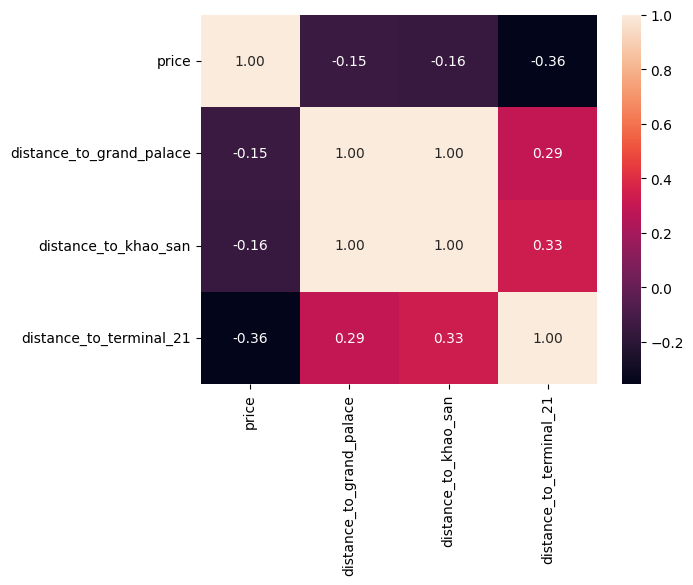

In [70]:
# heatmap korelasi
sns.heatmap(corr, annot = True, fmt = '.2f')

**Insight:**
- Korelasi negatif yang lemah (-0.15) menunjukkan bahwa tidak ada hubungan yang kuat antara harga listing dan jarak ke Grand Palace. Listing yang lebih dekat dengan Grand Palace tidak selalu memiliki harga yang lebih tinggi, dan sebaliknya.
- Korelasi negatif yang lemah (-0.16) juga menunjukkan bahwa jarak ke Khao San Road tidak memiliki pengaruh signifikan terhadap harga listing. Ini bisa berarti bahwa harga listing tidak terlalu bergantung pada kedekatannya dengan jalan ini, meskipun Khao San Road adalah pusat turisme.
- Korelasi negatif yang lebih kuat (-0.36) antara harga dan jarak ke Terminal 21 menunjukkan bahwa listing yang lebih jauh dari Terminal 21 cenderung memiliki harga yang lebih tinggi. Ini mungkin menunjukkan bahwa area yang lebih jauh dari pusat perbelanjaan mewah seperti Terminal 21 lebih terjangkau, atau mungkin lebih cocok untuk penginapan jangka panjang.

## 17. Frekuensi Kata, Sentimen, dan Kata Kunci Populer Berdasarkan Ulasan
Analisis ini mengeksplorasi tiga aspek utama dari deskripsi listing Airbnb di Bangkok untuk memahami faktor-faktor yang memengaruhi popularitas dan persepsi tamu:
1. Frekuensi Kata  
   Menganalisis kata-kata yang paling sering digunakan dalam deskripsi listing untuk mengidentifikasi fitur, fasilitas, atau keunggulan yang sering ditekankan oleh host.
2. Analisis Sentimen 
   Menilai sentimen dalam deskripsi listing—apakah cenderung positif, negatif, atau netral—untuk memahami bagaimana gaya komunikasi host dapat memengaruhi daya tarik listing.
3. Kata Kunci Populer 
   Mengidentifikasi kata-kata yang paling sering muncul pada listing dengan jumlah ulasan tertinggi, yang dapat menunjukkan fitur atau karakteristik yang paling disukai oleh tamu.

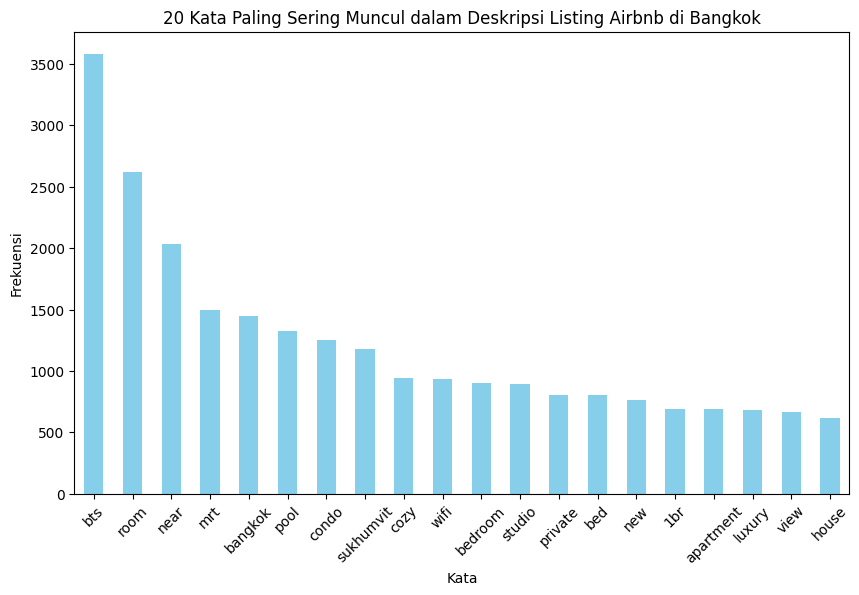

In [71]:
from sklearn.feature_extraction.text import CountVectorizer

# Membaca data deskripsi dari kolom 'name'
descriptions = df['name'].fillna('')  # Mengisi missing values dengan string kosong

# Inisialisasi CountVectorizer
vectorizer = CountVectorizer(stop_words='english', max_features=20)  # Mengambil 20 kata terpopuler

# Mengubah deskripsi menjadi matriks fitur kata
X = vectorizer.fit_transform(descriptions)

# Mengubah hasil menjadi dataframe
word_freq = pd.DataFrame(X.toarray(), columns=vectorizer.get_feature_names_out())

# Menampilkan kata-kata paling sering muncul
top_words = word_freq.sum().sort_values(ascending=False).head(20)

# Visualisasi frekuensi kata
plt.figure(figsize=(10, 6))
top_words.plot(kind='bar', color='skyblue')
plt.title('20 Kata Paling Sering Muncul dalam Deskripsi Listing Airbnb di Bangkok')
plt.xlabel('Kata')
plt.ylabel('Frekuensi')
plt.xticks(rotation=45)
plt.show()

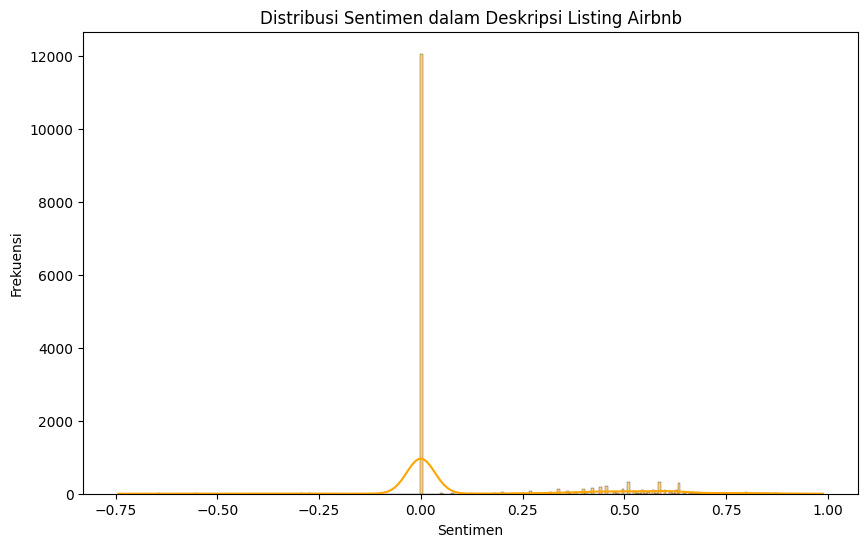

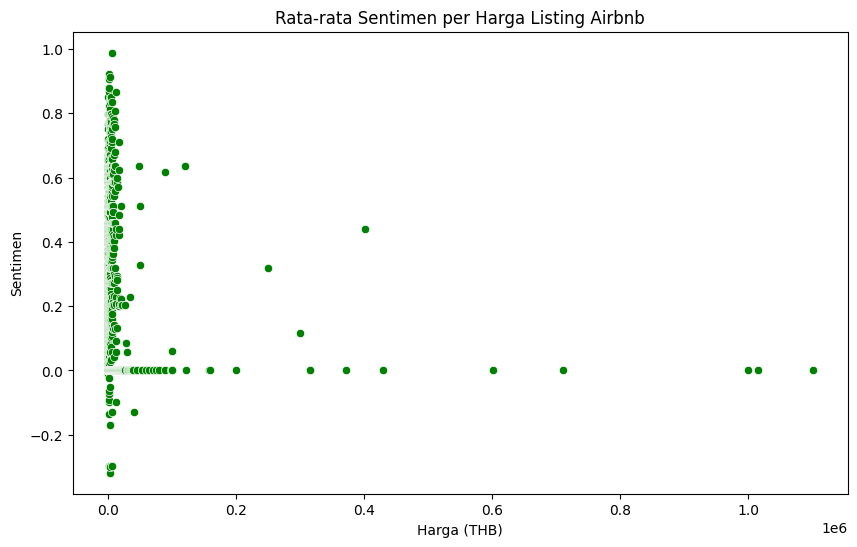

In [73]:
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Inisialisasi SentimentIntensityAnalyzer
sia = SentimentIntensityAnalyzer()

# Menghitung sentimen untuk setiap deskripsi
df['sentiment'] = df['name'].apply(lambda x: sia.polarity_scores(x)['compound'])

# Menampilkan distribusi sentimen
plt.figure(figsize=(10, 6))
sns.histplot(df['sentiment'], kde=True, color='orange')
plt.title('Distribusi Sentimen dalam Deskripsi Listing Airbnb')
plt.xlabel('Sentimen')
plt.ylabel('Frekuensi')
plt.show()

# Menampilkan rata-rata sentimen berdasarkan harga
avg_sentiment_by_price = df.groupby('price')['sentiment'].mean()

# Visualisasi sentimen berdasarkan harga
plt.figure(figsize=(10, 6))
sns.scatterplot(x=avg_sentiment_by_price.index, y=avg_sentiment_by_price.values, color='green')
plt.title('Rata-rata Sentimen per Harga Listing Airbnb')
plt.xlabel('Harga (THB)')
plt.ylabel('Sentimen')
plt.show()

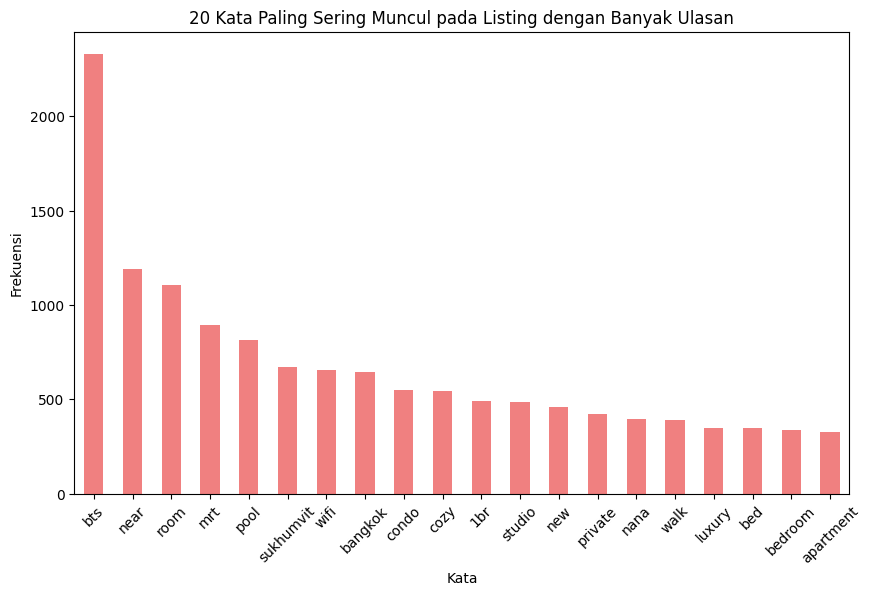

In [72]:
# Mengelompokkan listing berdasarkan jumlah ulasan
popular_listings = df[df['number_of_reviews'] > df['number_of_reviews'].median()]

# Menghitung frekuensi kata pada listing populer
descriptions_popular = popular_listings['name'].fillna('')
X_popular = vectorizer.fit_transform(descriptions_popular)
word_freq_popular = pd.DataFrame(X_popular.toarray(), columns=vectorizer.get_feature_names_out())
top_words_popular = word_freq_popular.sum().sort_values(ascending=False).head(20)

# Visualisasi kata-kata populer pada listing dengan banyak ulasan
plt.figure(figsize=(10, 6))
top_words_popular.plot(kind='bar', color='lightcoral')
plt.title('20 Kata Paling Sering Muncul pada Listing dengan Banyak Ulasan')
plt.xlabel('Kata')
plt.ylabel('Frekuensi')
plt.xticks(rotation=45)
plt.show()

**Insight:**

## 18. Pengaruh Waktu Terakhir Ulasan terhadap Harga dan Jumlah Ulasan pada Listing Airbnb di Bangkok
Analisis ini mengeksplorasi pengaruh waktu ulasan terakhir terhadap dua faktor penting di pasar Airbnb Bangkok:
1. **Harga Listing**  
   Menilai apakah waktu yang telah berlalu sejak ulasan terakhir memengaruhi harga yang ditetapkan oleh host.
2. **Jumlah Ulasan**  
   Mengamati hubungan antara waktu ulasan terakhir dan jumlah ulasan yang diterima oleh sebuah listing.
Dengan menganalisis variabel `days_since_last_review`, dapat dipahami apakah listing yang sudah lama tidak mendapat ulasan cenderung memiliki harga lebih rendah atau lebih tinggi. Selain itu, analisis ini juga melihat apakah waktu tanpa ulasan berdampak pada popularitas listing. Pola musiman atau perubahan signifikan dalam harga dan ulasan seiring waktu juga menjadi bagian dari eksplorasi ini.

In [106]:
num_columns = ['days_since_last_review', 'price', 'number_of_reviews']

# Menghitung korelasi antara 'days_since_last_review', 'price', dan 'number_of_reviews'
corr = df[num_columns].corr(method = 'spearman')
corr

,days_since_last_review,price,number_of_reviews
days_since_last_review,1.000000,-0.109934,-0.348556
price,-0.109934,1.000000,-0.020953
number_of_reviews,-0.348556,-0.020953,1.000000


<Axes: >

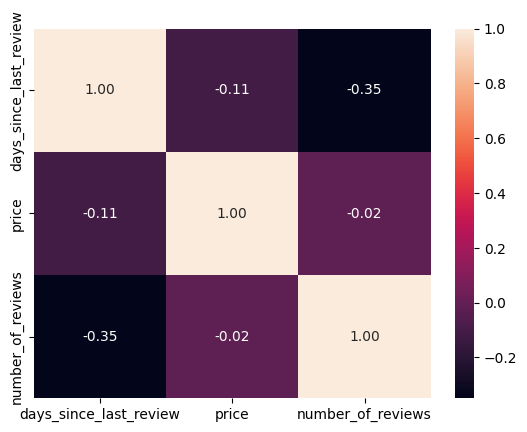

In [107]:
# heatmap korelasi
sns.heatmap(corr, annot = True, fmt = '.2f')

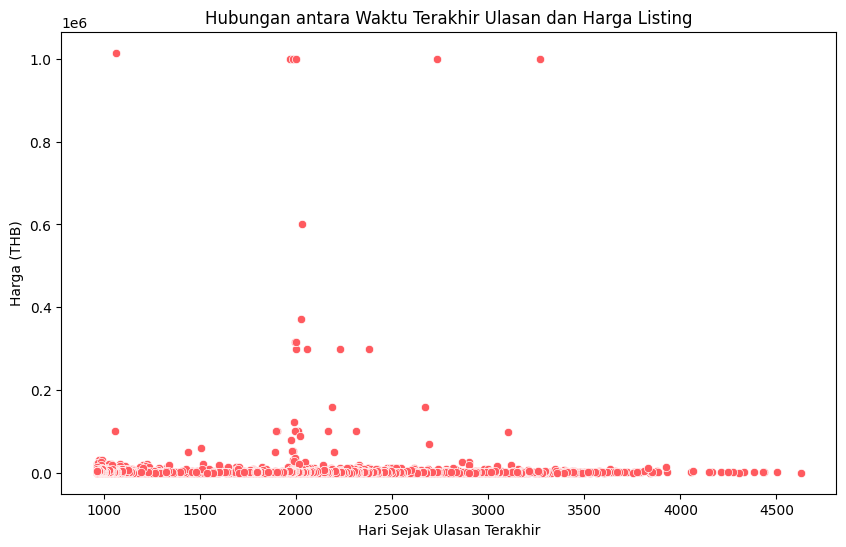

In [98]:
# Visualisasi harga berdasarkan jumlah hari sejak ulasan terakhir
plt.figure(figsize=(10, 6))
sns.scatterplot(x='days_since_last_review', y='price', data=df, color='#FF5A5F')
plt.title('Hubungan antara Waktu Terakhir Ulasan dan Harga Listing')
plt.xlabel('Hari Sejak Ulasan Terakhir')
plt.ylabel('Harga (THB)')
plt.show()

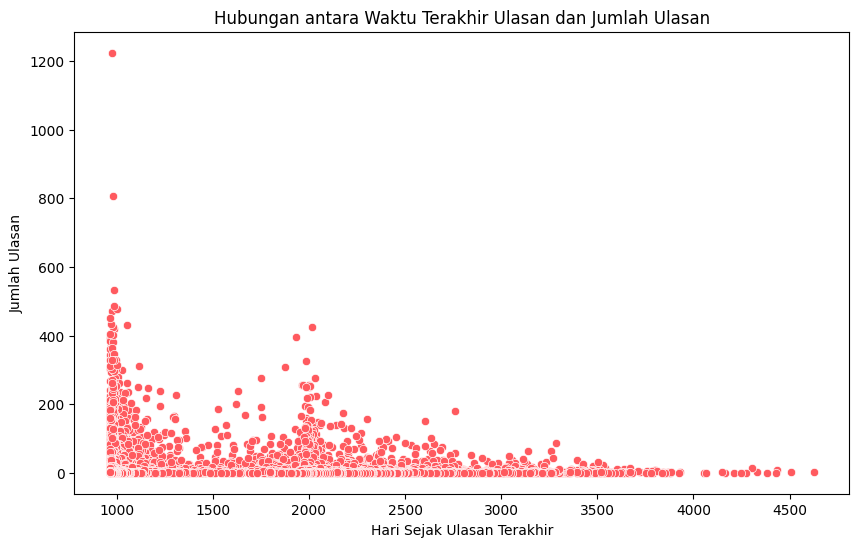

In [97]:
# Visualisasi jumlah ulasan berdasarkan jumlah hari sejak ulasan terakhir
plt.figure(figsize=(10, 6))
sns.scatterplot(x='days_since_last_review', y='number_of_reviews', data=df, color='#FF5A5F')
plt.title('Hubungan antara Waktu Terakhir Ulasan dan Jumlah Ulasan')
plt.xlabel('Hari Sejak Ulasan Terakhir')
plt.ylabel('Jumlah Ulasan')
plt.show()

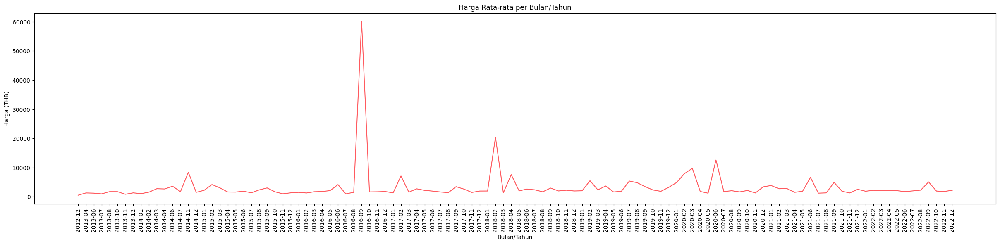

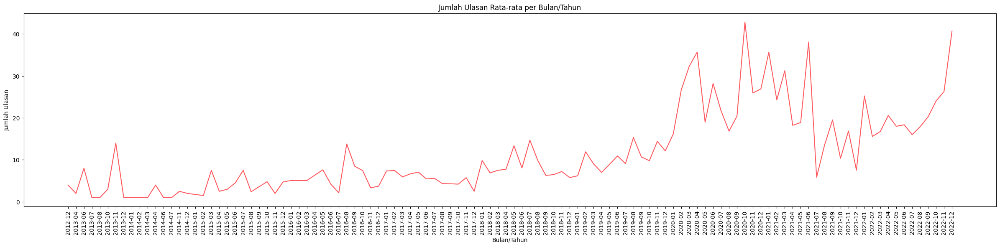

In [96]:
# Menambahkan kolom bulan tahun untuk analisis lebih lanjut
df['month_year'] = df['last_review'].dt.to_period('M')

# Rata-rata harga dan jumlah ulasan per bulan tahun
price_by_month_year = df.groupby('month_year')['price'].mean()
reviews_by_month_year = df.groupby('month_year')['number_of_reviews'].mean()

# Visualisasi harga dan jumlah ulasan per bulan tahun
plt.figure(figsize=(30, 6))
sns.lineplot(x=price_by_month_year.index.astype(str), y=price_by_month_year.values, color='#FF5A5F')
plt.title('Harga Rata-rata per Bulan/Tahun')
plt.xlabel('Bulan/Tahun')
plt.ylabel('Harga (THB)')
plt.xticks(rotation=90)
plt.show()

plt.figure(figsize=(30, 6))
sns.lineplot(x=reviews_by_month_year.index.astype(str), y=reviews_by_month_year.values, color='#FF5A5F')
plt.title('Jumlah Ulasan Rata-rata per Bulan/Tahun')
plt.xlabel('Bulan/Tahun')
plt.ylabel('Jumlah Ulasan')
plt.xticks(rotation=90)
plt.show()

## 19. Pengaruh Jumlah Listing yang Dikelola Host terhadap Harga dan Jumlah Ulasan
Analisis ini bertujuan untuk mengeksplorasi hubungan antara jumlah listing yang dikelola oleh host dengan harga dan jumlah ulasan yang diterima. Dengan membandingkan host profesional (yang mengelola lebih dari satu listing) dan host non-profesional (yang mengelola satu listing), analisis ini mengungkapkan apakah host yang mengelola lebih banyak listing cenderung menetapkan harga yang lebih tinggi atau menerima lebih banyak ulasan. Visualisasi menggunakan scatter plot dan boxplot membantu memberikan pemahaman tentang bagaimana jumlah listing yang dikelola memengaruhi harga dan popularitas listing di pasar Airbnb.

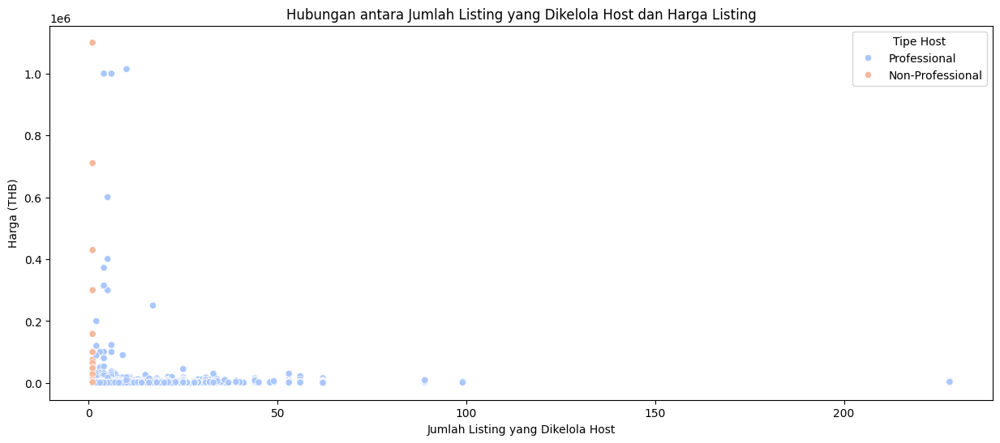

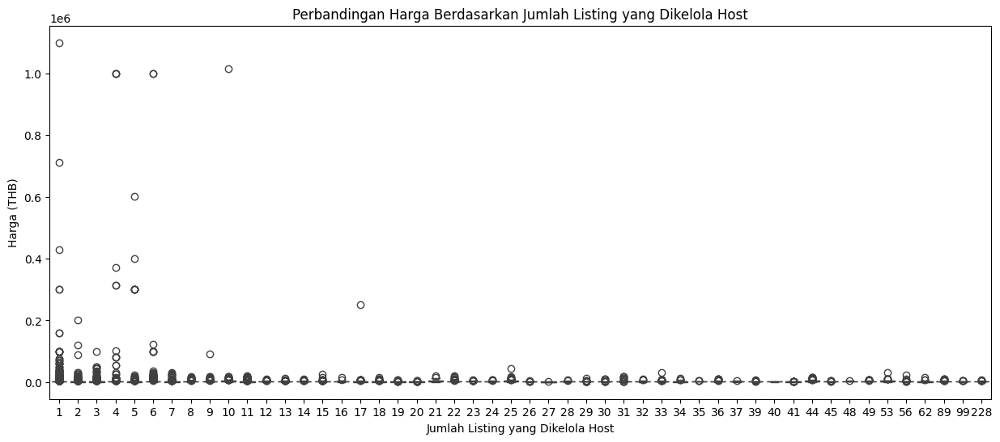

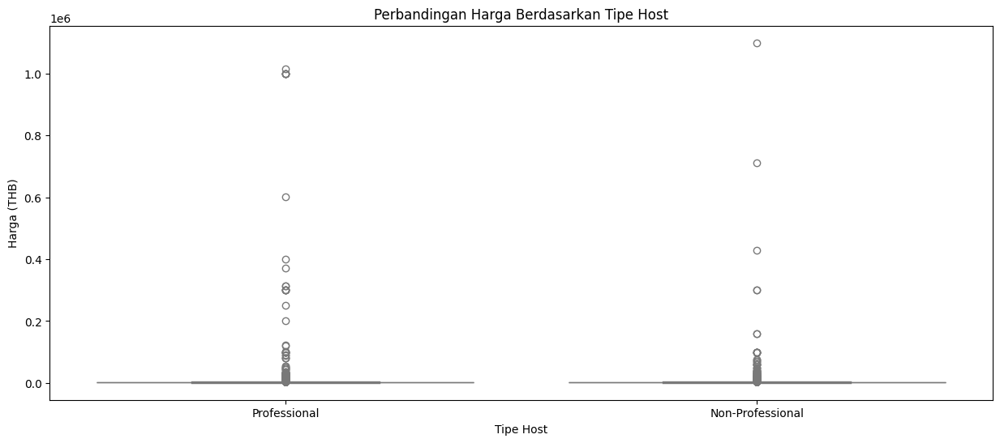

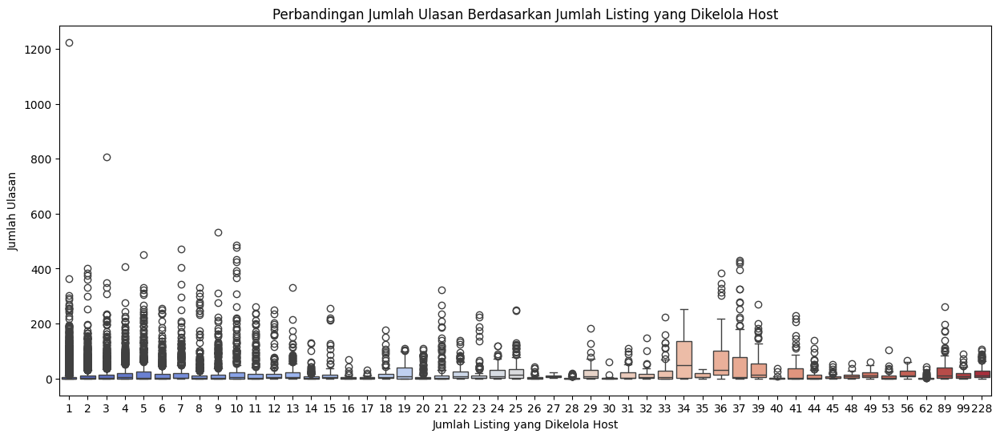

In [77]:
# Membandingkan harga dengan jumlah listing yang dikelola oleh host
plt.figure(figsize=(15, 6))
sns.scatterplot(x=df['calculated_host_listings_count'], y=df['price'], hue=df['host_type'], palette='coolwarm')
plt.title('Hubungan antara Jumlah Listing yang Dikelola Host dan Harga Listing')
plt.xlabel('Jumlah Listing yang Dikelola Host')
plt.ylabel('Harga (THB)')
plt.legend(title='Tipe Host', loc='upper right')
plt.show()

# Visualisasi harga berdasarkan jumlah listing yang dikelola oleh host
plt.figure(figsize=(15, 6))
sns.boxplot(x='calculated_host_listings_count', y='price', data=df, palette='coolwarm')
plt.title('Perbandingan Harga Berdasarkan Jumlah Listing yang Dikelola Host')
plt.xlabel('Jumlah Listing yang Dikelola Host')
plt.ylabel('Harga (THB)')
plt.show()

# Membandingkan harga berdasarkan jenis host (host profesional vs non-profesional)
plt.figure(figsize=(15, 6))
sns.boxplot(x='host_type', y='price', data=df, palette='coolwarm')
plt.title('Perbandingan Harga Berdasarkan Tipe Host')
plt.xlabel('Tipe Host')
plt.ylabel('Harga (THB)')
plt.show()

# Membandingkan jumlah ulasan berdasarkan jumlah listing yang dikelola oleh host
plt.figure(figsize=(15, 6))
sns.boxplot(x='calculated_host_listings_count', y='number_of_reviews', data=df, palette='coolwarm')
plt.title('Perbandingan Jumlah Ulasan Berdasarkan Jumlah Listing yang Dikelola Host')
plt.xlabel('Jumlah Listing yang Dikelola Host')
plt.ylabel('Jumlah Ulasan')
plt.show()

## 20. Tren Musiman Harga dan Ulasan pada Listing Airbnb di Bangkok
Selanjutnya akan digali tren musiman yang memengaruhi harga dan jumlah ulasan pada listing Airbnb di Bangkok. Dengan menggunakan data ulasan terakhir (last_review), akan mengelompokkan data berdasarkan bulan dan musim untuk melihat apakah terdapat fluktuasi harga atau peningkatan jumlah ulasan pada musim-musim tertentu. Analisis ini dapat membantu para host memahami kapan harga mereka cenderung lebih tinggi atau kapan mereka bisa mendapatkan lebih banyak ulasan, serta mengidentifikasi musim terbaik untuk meningkatkan pendapatan.

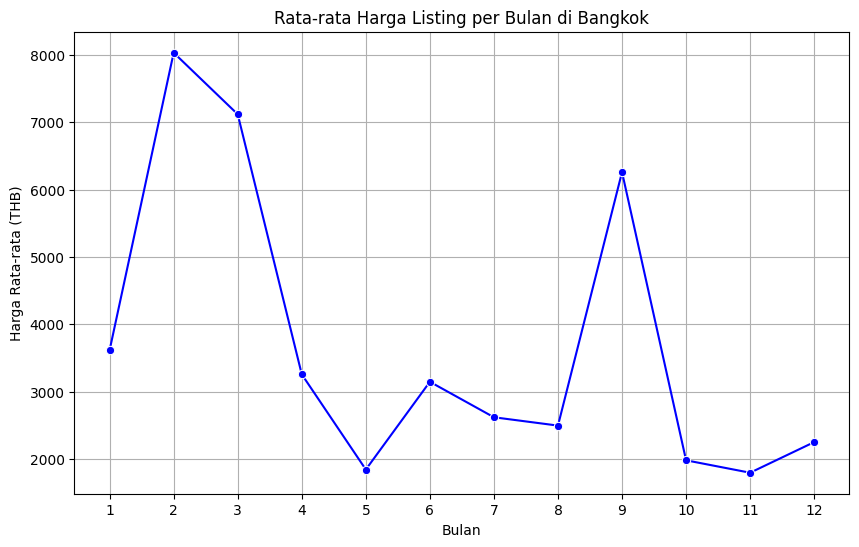

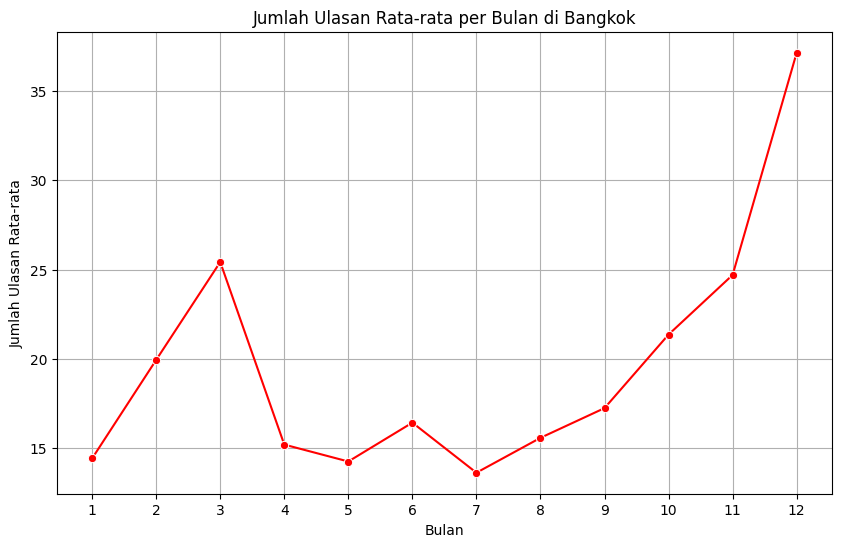

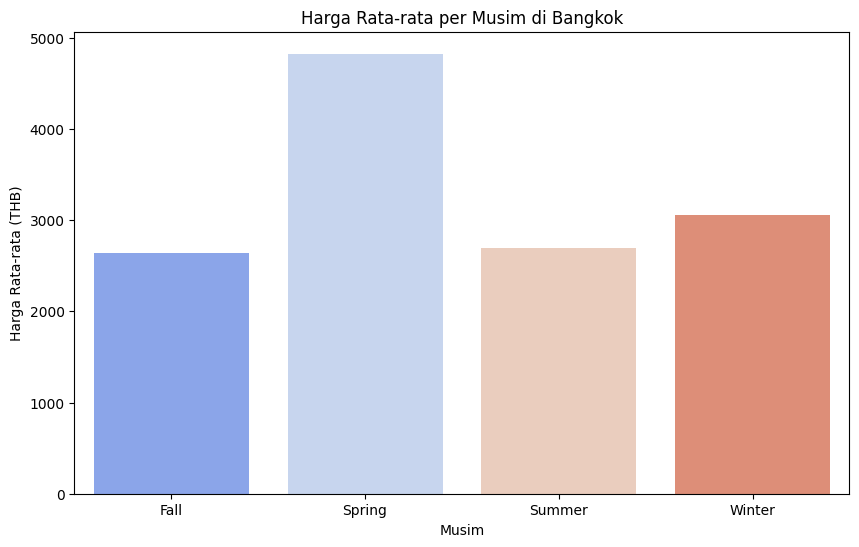

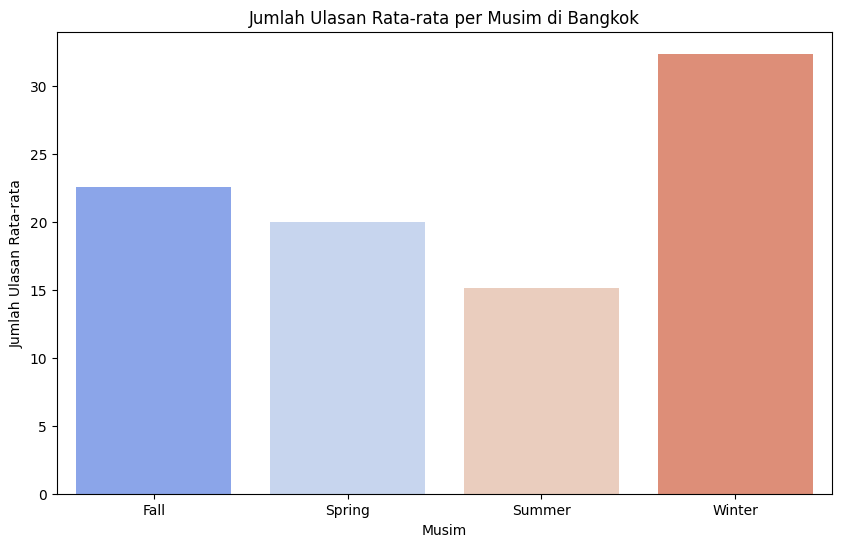

In [74]:
# Menambahkan kolom 'month' dan 'year' untuk mengelompokkan data berdasarkan bulan dan tahun
df['month'] = df['last_review'].dt.month
df['year'] = df['last_review'].dt.year

# Mengelompokkan harga dan jumlah ulasan per bulan untuk melihat tren musiman
price_per_month = df.groupby('month')['price'].mean()
reviews_per_month = df.groupby('month')['number_of_reviews'].mean()

# Visualisasi perubahan harga rata-rata per bulan
plt.figure(figsize=(10, 6))
sns.lineplot(x=price_per_month.index, y=price_per_month.values, marker='o', color='blue')
plt.title('Rata-rata Harga Listing per Bulan di Bangkok')
plt.xlabel('Bulan')
plt.ylabel('Harga Rata-rata (THB)')
plt.xticks(range(1, 13))
plt.grid(True)
plt.show()

# Visualisasi perubahan jumlah ulasan per bulan
plt.figure(figsize=(10, 6))
sns.lineplot(x=reviews_per_month.index, y=reviews_per_month.values, marker='o', color='red')
plt.title('Jumlah Ulasan Rata-rata per Bulan di Bangkok')
plt.xlabel('Bulan')
plt.ylabel('Jumlah Ulasan Rata-rata')
plt.xticks(range(1, 13))
plt.grid(True)
plt.show()

# Jika ingin analisis berdasarkan musim, kita bisa menambahkan kolom 'season' berdasarkan bulan
season_mapping = {1: 'Winter', 2: 'Winter', 3: 'Spring', 4: 'Spring', 5: 'Spring', 6: 'Summer',
                  7: 'Summer', 8: 'Summer', 9: 'Fall', 10: 'Fall', 11: 'Fall', 12: 'Winter'}
df['season'] = df['month'].map(season_mapping)

# Mengelompokkan harga per musim
price_per_season = df.groupby('season')['price'].mean()

# Visualisasi harga rata-rata per musim
plt.figure(figsize=(10, 6))
sns.barplot(x=price_per_season.index, y=price_per_season.values, palette='coolwarm')
plt.title('Harga Rata-rata per Musim di Bangkok')
plt.xlabel('Musim')
plt.ylabel('Harga Rata-rata (THB)')
plt.show()

# Mengelompokkan jumlah ulasan per musim
reviews_per_season = df.groupby('season')['number_of_reviews'].mean()

# Visualisasi jumlah ulasan per musim
plt.figure(figsize=(10, 6))
sns.barplot(x=reviews_per_season.index, y=reviews_per_season.values, palette='coolwarm')
plt.title('Jumlah Ulasan Rata-rata per Musim di Bangkok')
plt.xlabel('Musim')
plt.ylabel('Jumlah Ulasan Rata-rata')
plt.show()

**Insight:**
### 1. Tren Harga Rata-rata per Bulan:
- Harga tertinggi terjadi pada bulan Februari dengan rata-rata harga hampir 8,000 THB, yang kemungkinan besar berkaitan dengan musim liburan atau acara tertentu di Bangkok, di mana permintaan akomodasi meningkat.
- Penurunan harga signifikan terjadi pada bulan Maret hingga Juni, dengan harga rata-rata cenderung lebih rendah sekitar 2,000–3,000 THB, yang mungkin mencerminkan periode di luar musim puncak wisata.
- Kenaikan harga kembali terjadi pada bulan September, yang menunjukkan adanya lonjakan permintaan mendekati akhir tahun (musim liburan).

### 2. Tren Jumlah Ulasan per Bulan:
- Puncak jumlah ulasan terjadi pada bulan Desember, dengan rata-rata ulasan per listing lebih dari 35 ulasan. Ini menunjukkan bahwa bulan-bulan akhir tahun cenderung menjadi waktu di mana banyak tamu menginap dan meninggalkan ulasan, mungkin terkait dengan musim liburan dan puncak kunjungan wisatawan.
- Jumlah ulasan terendah terjadi pada bulan April hingga Juni, yang mencerminkan periode dengan lebih sedikit aktivitas wisatawan atau mungkin pengaruh liburan lokal yang lebih rendah di Thailand.

### 3. Harga Rata-rata per Musim:
- Spring (Musim Semi) memiliki harga rata-rata tertinggi, mendekati 4,500 THB. Ini menunjukkan bahwa selama musim semi, permintaan akan listing di Airbnb cenderung lebih tinggi, mungkin karena cuaca yang nyaman dan beragam acara atau festival.
- Fall (Musim Gugur) sedikit lebih rendah dibandingkan dengan Spring, tetapi masih menunjukkan harga yang stabil pada kisaran 2,000–2,500 THB.
- Winter (Musim Dingin) menunjukkan harga sedikit lebih tinggi dibandingkan Summer, dengan harga sekitar 3,000–3,500 THB, yang berhubungan dengan musim liburan dan periode permintaan tinggi di kawasan tropis.

### 4. Jumlah Ulasan per Musim:
- Winter mencatatkan jumlah ulasan tertinggi, lebih dari 25 ulasan rata-rata per listing. Ini mengindikasikan bahwa lebih banyak tamu menginap selama musim liburan akhir tahun dan memberikan ulasan lebih banyak.
- Fall memiliki jumlah ulasan yang relatif stabil, sedikit lebih tinggi daripada Spring dan Summer, mencerminkan perjalanan yang lebih santai atau tamu yang datang selama musim yang lebih sejuk.
- Spring dan Summer memiliki jumlah ulasan yang lebih rendah dan relatif stabil, yang mungkin menandakan periode wisata yang lebih sedikit dibandingkan musim puncak (Winter).

### Kesimpulan:
- Puncak harga dan jumlah ulasan terjadi pada bulan Desember dan sekitar musim liburan (Winter), mengindikasikan periode permintaan tinggi di Airbnb Bangkok.
- Harga terendah terjadi pada musim panas (Summer), dengan fluktuasi yang lebih besar pada bulan-bulan tertentu, mencerminkan musim rendah wisata.

# Rekomendasi & Saran untuk Host Airbnb

## Rekomendasi
Setelah melakukan analisis terhadap berbagai faktor yang mempengaruhi performa listing Airbnb di Bangkok, berikut adalah rekomendasi yang lebih terperinci dan berbasis temuan yang relevan untuk host agar dapat mengoptimalkan pendapatan dan tingkat okupansi mereka:

1. Mengoptimalkan Harga
    - Berdasarkan analisis perbandingan harga, tampak bahwa listing yang memiliki harga lebih rendah cenderung memiliki okupansi yang lebih tinggi. Oleh karena itu, host yang memiliki harga tinggi dan sedikit ulasan sebaiknya mempertimbangkan penurunan harga sementara untuk menarik lebih banyak tamu dan meningkatkan ulasan.
    - Segmentasi harga juga menunjukkan bahwa listing dengan harga rendah cenderung lebih sering tersedia. Untuk host dengan listing harga tinggi, penyesuaian harga dapat meningkatkan tingkat okupansi, terutama dengan menawarkan diskon atau promo khusus.

2. Menentukan Jenis Kamar yang Tepat
    - Tipe kamar seperti Entire home/apt lebih dominan dan banyak diminati oleh tamu, terutama untuk keluarga atau grup. Host yang mengelola tipe kamar lain seperti Shared room atau Hotel room perlu memperhatikan penyesuaian harga atau fasilitas untuk menarik lebih banyak tamu.
    - Private room memiliki performa yang stabil, tetapi host dapat meningkatkan pengalaman tamu dengan memperbaiki kualitas foto, deskripsi yang lebih menarik, atau fasilitas tambahan untuk lebih menonjolkan privasi.

3. Fokus pada Lokasi yang Tepat
    - Analisis neighborhood menunjukkan bahwa beberapa kawasan, seperti Vadhana dan Khlong Toei, memiliki persaingan yang lebih ketat karena jumlah listing yang tinggi. Host di area ini bisa lebih menonjolkan keunikan properti mereka, menawarkan diskon musiman, atau meningkatkan kualitas pelayanan untuk bersaing lebih baik.
    - Di kawasan yang lebih sedikit listing, peningkatan visibilitas melalui foto yang menarik, deskripsi yang lengkap, dan penyesuaian harga bisa menjadi strategi yang efektif untuk menarik lebih banyak tamu.

4. Fokus pada Ulasan Positif
    - Berdasarkan analisis ulasan, listing yang memiliki lebih banyak ulasan cenderung lebih sukses dalam menarik tamu. Host yang memiliki sedikit ulasan dapat memperbaiki kualitas layanan dan mendorong tamu untuk meninggalkan ulasan melalui insentif atau diskon untuk ulasan pertama.
    - Meningkatkan kualitas deskripsi dan foto listing juga dapat membantu meningkatkan daya tarik dan akhirnya mendapatkan lebih banyak ulasan.

5. Durasi Menginap yang Fleksibel
    - Sebagian besar listing menawarkan durasi menginap yang sangat singkat (1 malam). Host yang menetapkan durasi panjang (misalnya lebih dari 3 malam) dapat meningkatkan okupansi dengan menawarkan lebih banyak fleksibilitas pada durasi menginap, sehingga menarik tamu dengan kebutuhan jangka pendek atau liburan singkat.
    - Segmentasi harga dan durasi menginap menunjukkan bahwa listing dengan harga rendah lebih sering tersedia, jadi untuk host dengan harga lebih tinggi, menyediakan lebih banyak opsi fleksibel (misalnya potongan harga untuk menginap lebih lama) bisa membantu meningkatkan tingkat okupansi.

6. Pertimbangkan Tipe Host dan Manajemen Listing
    - Mayoritas host di Bangkok adalah profesional, yang mungkin lebih berpengalaman dalam mengelola banyak listing. Host non-profesional bisa mendapat manfaat dari mengikuti panduan pengelolaan listing yang lebih efektif, seperti menggunakan tools otomatis Airbnb atau mengikuti pelatihan untuk meningkatkan kualitas listing mereka.

7. Mengelola Tingkat Ketersediaan dan Okupansi
    - Listing dengan harga rendah lebih sering tersedia, sementara harga tinggi cenderung memiliki okupansi yang lebih rendah. Host yang mengelola listing lebih mahal dapat mempertimbangkan kebijakan harga fleksibel untuk meningkatkan okupansi, misalnya dengan memberikan harga promosi atau menawarkan penurunan harga selama periode low season.

8. Strategi Berdasarkan Harga dan Ulasan
    - Berdasarkan analisis harga dan ulasan, harga yang lebih tinggi tidak selalu berhubungan dengan lebih banyak ulasan. Untuk host dengan harga tinggi, memfokuskan pada peningkatan kualitas pelayanan (misalnya, lebih banyak fasilitas premium, perbaikan di aspek pengalaman tamu, atau memperbaiki foto listing) dapat meningkatkan jumlah ulasan dan memperbaiki performa.

## Kesimpulan

Dengan menerapkan rekomendasi ini, host Airbnb dapat lebih mengoptimalkan harga, durasi sewa, dan kualitas listing untuk meningkatkan okupansi dan pendapatan. Penyesuaian harga yang lebih cermat, peningkatan kualitas pelayanan, dan strategi ulasan yang efektif akan membantu host mengatasi tantangan persaingan yang ketat dan memaksimalkan potensi keuntungan mereka.